In [2]:
import os, zipfile, shutil, random, glob, imghdr
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import train_test_split

In [3]:
# Reproducibility
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

In [4]:
# STEP 0️⃣: GPU Check
# ========================================================================================
import tensorflow as tf
print("TensorFlow version:", tf.__version__)
print("GPU Available:", tf.config.list_physical_devices('GPU'))



TensorFlow version: 2.19.0
GPU Available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [5]:

# ========================================================================================
# STEP 1️⃣: UPLOAD ZIP FILES (leaf.zip and non-leaf.zip)
# ========================================================================================
from google.colab import files
import zipfile, os, random, shutil
from pathlib import Path

print("Please upload leaf.zip and non-leaf.zip from your PC...")
uploaded = files.upload()

BASE_DIR = Path("/content")
leaf_zip = BASE_DIR / "leaf.zip"
non_leaf_zip = BASE_DIR / "non-leaf.zip"
data_dir = BASE_DIR / "dataset"

# Clean previous folders if exist
if data_dir.exists():
    shutil.rmtree(data_dir)
data_dir.mkdir(parents=True, exist_ok=True)

# Extract both zips
with zipfile.ZipFile(leaf_zip, 'r') as z:
    z.extractall(data_dir / "leaf")
with zipfile.ZipFile(non_leaf_zip, 'r') as z:
    z.extractall(data_dir / "non_leaf")

print("Files extracted successfully!")

Please upload leaf.zip and non-leaf.zip from your PC...


Saving leaf.zip to leaf.zip
Saving non-leaf.zip to non-leaf.zip
Files extracted successfully!


In [6]:
# Identify uploaded filenames
uploaded_files = list(uploaded.keys())
if not uploaded_files:
    raise RuntimeError("No files uploaded. Upload leaf.zip and non-leaf.zip")

In [7]:
# ---------- 2) EXTRACT ZIPs (to /content/dataset/leaf and .../non_leaf) ----------
BASE = Path("/content")
DATA_DIR = BASE / "dataset"
if DATA_DIR.exists():
    shutil.rmtree(DATA_DIR)
DATA_DIR.mkdir(parents=True, exist_ok=True)

# define targets
leaf_target = DATA_DIR / "leaf"
nonleaf_target = DATA_DIR / "non_leaf"
leaf_target.mkdir(parents=True, exist_ok=True)
nonleaf_target.mkdir(parents=True, exist_ok=True)

# helper to match filenames loosely
def find_uploaded(name_hint):
    for fn in uploaded_files:
        if name_hint.lower() in fn.lower().replace("-", "_"):
            return fn
    return None

leaf_zip = find_uploaded("leaf")
nonleaf_zip = find_uploaded("non") or find_uploaded("non_leaf") or find_uploaded("non-leaf")

# if not found, fallback to first two files
if leaf_zip is None or nonleaf_zip is None:
    if len(uploaded_files) >= 2:
        leaf_zip = uploaded_files[0]
        nonleaf_zip = uploaded_files[1]
    else:
        raise RuntimeError("Couldn't detect both leaf and non-leaf zip files from uploads.")

# extract safely
def extract_zip_to(zipname, dest_dir):
    with zipfile.ZipFile(zipname, "r") as z:
        # extract all; images may be nested
        z.extractall(dest_dir)

extract_zip_to(leaf_zip, leaf_target)
extract_zip_to(nonleaf_zip, nonleaf_target)

print(f"Extracted to:\n - {leaf_target}\n - {nonleaf_target}")


Extracted to:
 - /content/dataset/leaf
 - /content/dataset/non_leaf


In [8]:
# ---------- 3) COLLECT IMAGES RECURSIVELY (only real image files) ----------
def collect_image_files(folder: Path):
    exts = (".jpg", ".jpeg", ".png", ".bmp", ".tiff", ".webp")
    files = [p for p in folder.rglob("*") if p.is_file() and p.suffix.lower() in exts]
    # double-check with imghdr to avoid copying other file types
    files = [str(p) for p in files if imghdr.what(p) is not None]
    return files

leaf_images = collect_image_files(leaf_target)
nonleaf_images = collect_image_files(nonleaf_target)
print(f"Found images -> leaf: {len(leaf_images)}, non_leaf: {len(nonleaf_images)}")

if len(leaf_images) == 0 or len(nonleaf_images) == 0:
    raise RuntimeError("One of the classes has zero images. Check the zip contents and re-run.")


Found images -> leaf: 1749, non_leaf: 1692


In [9]:
# ---------- 4) CREATE SPLIT DIRECTORIES AND COPY FILES ----------
SPLIT_DIR = DATA_DIR / "split"
if SPLIT_DIR.exists():
    shutil.rmtree(SPLIT_DIR)
for s in ["train", "val", "test"]:
    (SPLIT_DIR / s / "leaf").mkdir(parents=True, exist_ok=True)
    (SPLIT_DIR / s / "non_leaf").mkdir(parents=True, exist_ok=True)

def split_and_copy(image_paths, cls_name, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    # shuffle and split
    random.shuffle(image_paths)
    n = len(image_paths)
    n_train = int(n * train_ratio)
    n_val = int(n * val_ratio)
    # remainder to test
    train_files = image_paths[:n_train]
    val_files = image_paths[n_train:n_train+n_val]
    test_files = image_paths[n_train+n_val:]
    # copy
    for src_list, split in [(train_files, "train"), (val_files, "val"), (test_files, "test")]:
        for src in src_list:
            dst = SPLIT_DIR / split / cls_name / Path(src).name
            shutil.copy2(src, dst)

split_and_copy(leaf_images, "leaf")
split_and_copy(nonleaf_images, "non_leaf")

# counts
for s in ["train","val","test"]:
    l = len(list((SPLIT_DIR / s / "leaf").glob("*")))
    nl = len(list((SPLIT_DIR / s / "non_leaf").glob("*")))
    print(f"{s}: leaf={l}, non_leaf={nl}")


train: leaf=1224, non_leaf=1184
val: leaf=262, non_leaf=253
test: leaf=263, non_leaf=255


In [10]:
# ---------- 5) IMAGE GENERATORS (augmentation on train) ----------
IMG_SIZE = (128, 128)
BATCH_SIZE = 32

train_gen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    width_shift_range=0.18,
    height_shift_range=0.18,
    shear_range=0.15,
    zoom_range=0.25,
    horizontal_flip=True,
    vertical_flip=True,
    brightness_range=(0.75, 1.25),
    fill_mode="nearest"
).flow_from_directory(
    SPLIT_DIR / "train",
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode="binary",
    shuffle=True,
    seed=SEED
)

val_gen = ImageDataGenerator(rescale=1./255).flow_from_directory(
    SPLIT_DIR / "val",
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode="binary",
    shuffle=False
)

test_gen = ImageDataGenerator(rescale=1./255).flow_from_directory(
    SPLIT_DIR / "test",
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode="binary",
    shuffle=False
)

print("Class indices:", train_gen.class_indices)

Found 2408 images belonging to 2 classes.
Found 515 images belonging to 2 classes.
Found 518 images belonging to 2 classes.
Class indices: {'leaf': 0, 'non_leaf': 1}


In [12]:
# ---------- 6) BUILD MODEL (MobileNetV2 backbone + small head) ----------
def build_model(img_size=IMG_SIZE):
    inputs = keras.Input(shape=(*img_size, 3))
    aug = keras.Sequential([
        layers.RandomFlip("horizontal_and_vertical"),
        layers.RandomRotation(0.15),
        layers.RandomZoom(0.15)
    ], name="aug_layer")
    x = aug(inputs)

    base = keras.applications.MobileNetV2(
        input_shape=(*img_size, 3),
        include_top=False,
        weights="imagenet"
    )
    base.trainable = False
    x = base(x, training=False)
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.35)(x)
    x = layers.Dense(128, activation="relu")(x)
    x = layers.BatchNormalization()(x)
    x = layers.Dropout(0.25)(x)
    outputs = layers.Dense(1, activation="sigmoid")(x)
    model = keras.Model(inputs, outputs, name="leaf_detector")
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=1e-3),
        loss="binary_crossentropy",
        metrics=["accuracy", keras.metrics.Precision(name="precision"), keras.metrics.Recall(name="recall"), keras.metrics.AUC(name="auc")]
    )
    return model, base

model, base_model = build_model()
model.summary()


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "leaf_detector"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ aug_layer (Sequential)          │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_128            │ (None, 4, 4, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1280)           │         5,120 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,427,713 (9.26 MB)

 Trainable params: 166,913 (652.00 KB)

 Non-trainable params: 2,260,800 (8.62 MB)

In [13]:
# ---------- 7) CALLBACKS ----------
BEST_PATH = "/content/best_leaf_model.keras"
callbacks = [
    keras.callbacks.EarlyStopping(monitor="val_loss", patience=6, restore_best_weights=True, verbose=1),
    keras.callbacks.ReduceLROnPlateau(monitor="val_loss", factor=0.5, patience=3, min_lr=1e-7, verbose=1),
    keras.callbacks.ModelCheckpoint(BEST_PATH, monitor="val_accuracy", save_best_only=True, verbose=1)
]

In [16]:
# ---------- 8) TRAIN PHASE 1 (frozen base) ----------
EPOCHS_PHASE1 = 10
history1 = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=EPOCHS_PHASE1,
    callbacks=callbacks,
    verbose=1
)


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
76/76 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step - accuracy: 0.9292 - auc: 0.9726 - loss: 0.1697 - precision: 0.9453 - recall: 0.9036
Epoch 1: val_accuracy improved from -inf to 0.99417, saving model to /content/best_leaf_model.keras
76/76 ━━━━━━━━━━━━━━━━━━━━ 37s 277ms/step - accuracy: 0.9297 - auc: 0.9729 - loss: 0.1687 - precision: 0.9456 - recall: 0.9043 - val_accuracy: 0.9942 - val_auc: 1.0000 - val_loss: 0.0191 - val_precision: 1.0000 - val_recall: 0.9881 - learning_rate: 0.0010
Epoch 2/10
76/76 ━━━━━━━━━━━━━━━━━━━━ 0s 200ms/step - accuracy: 0.9870 - auc: 0.9990 - loss: 0.0345 - precision: 0.9885 - recall: 0.9852
Epoch 2: val_accuracy improved from 0.99417 to 0.99806, saving model to /content/best_leaf_model.keras
76/76 ━━━━━━━━━━━━━━━━━━━━ 16s 215ms/step - accuracy: 0.9870 - auc: 0.9990 - loss: 0.0345 - precision: 0.9885 - recall: 0.9852 - val_accuracy: 0.9981 - val_auc: 1.0000 - val_loss: 0.0083 - val_precision: 1.0000 - val_recall: 0.9960 - learning_rate: 0.0010
Epoch 3/10


In [17]:
# ---------- 9) FINE-TUNE PHASE 2 ----------
# unfreeze some layers
base_model.trainable = True
# freeze early layers (keep first N frozen)
freeze_until = 100
for layer in base_model.layers[:freeze_until]:
    layer.trainable = False

# recompile with lower lr
model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=1e-4),
    loss="binary_crossentropy",
    metrics=["accuracy", keras.metrics.Precision(name="precision"), keras.metrics.Recall(name="recall"), keras.metrics.AUC(name="auc")]
)

EPOCHS_PHASE2 = 5
history2 = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=EPOCHS_PHASE1 + EPOCHS_PHASE2,
    initial_epoch=EPOCHS_PHASE1,
    callbacks=callbacks,
    verbose=1
)

Epoch 11/15
76/76 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step - accuracy: 0.9720 - auc: 0.9958 - loss: 0.0812 - precision: 0.9623 - recall: 0.9799
Epoch 11: val_accuracy did not improve from 1.00000
76/76 ━━━━━━━━━━━━━━━━━━━━ 34s 249ms/step - accuracy: 0.9721 - auc: 0.9959 - loss: 0.0809 - precision: 0.9625 - recall: 0.9799 - val_accuracy: 0.9903 - val_auc: 0.9980 - val_loss: 0.0286 - val_precision: 1.0000 - val_recall: 0.9802 - learning_rate: 1.0000e-04
Epoch 12/15
76/76 ━━━━━━━━━━━━━━━━━━━━ 0s 214ms/step - accuracy: 0.9899 - auc: 0.9988 - loss: 0.0347 - precision: 0.9848 - recall: 0.9946
Epoch 12: val_accuracy did not improve from 1.00000
76/76 ━━━━━━━━━━━━━━━━━━━━ 17s 225ms/step - accuracy: 0.9899 - auc: 0.9987 - loss: 0.0348 - precision: 0.9847 - recall: 0.9946 - val_accuracy: 0.9845 - val_auc: 1.0000 - val_loss: 0.0373 - val_precision: 1.0000 - val_recall: 0.9684 - learning_rate: 1.0000e-04
Epoch 13/15
76/76 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - accuracy: 0.9919 - auc: 0.9990 - loss: 0.0252

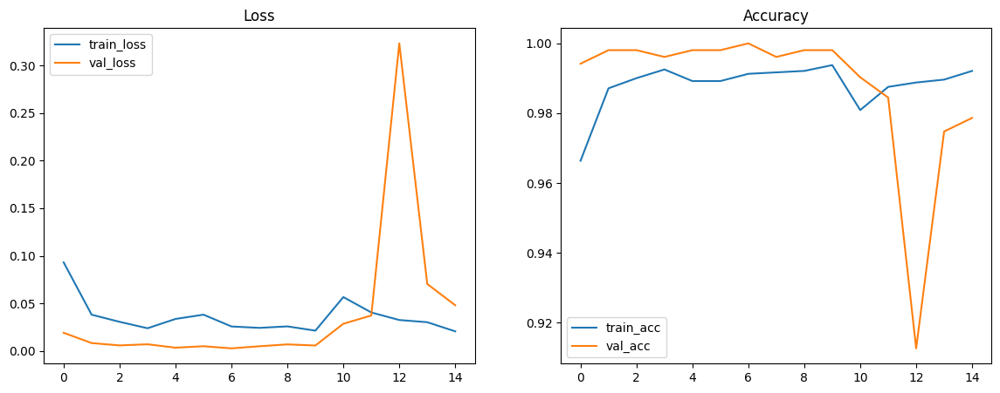

In [18]:
# ---------- 10) PLOT TRAINING HISTORY ----------
def plot_hist(h1, h2):
    # combine histories
    hist = {}
    for k in h1.history.keys():
        hist[k] = h1.history[k] + h2.history.get(k, [])
    plt.figure(figsize=(14,5))
    plt.subplot(1,2,1)
    plt.plot(hist["loss"], label="train_loss")
    plt.plot(hist["val_loss"], label="val_loss")
    plt.title("Loss")
    plt.legend()
    plt.subplot(1,2,2)
    plt.plot(hist["accuracy"], label="train_acc")
    plt.plot(hist["val_accuracy"], label="val_acc")
    plt.title("Accuracy")
    plt.legend()
    plt.show()

plot_hist(history1, history2)


In [21]:
print("Class names:", train.class_names)

NameError: name 'train' is not defined


Test Accuracy: 98.46%
Precision: 1.0000, Recall: 0.9686, AUC: 0.9980
F1-Score: 0.9841


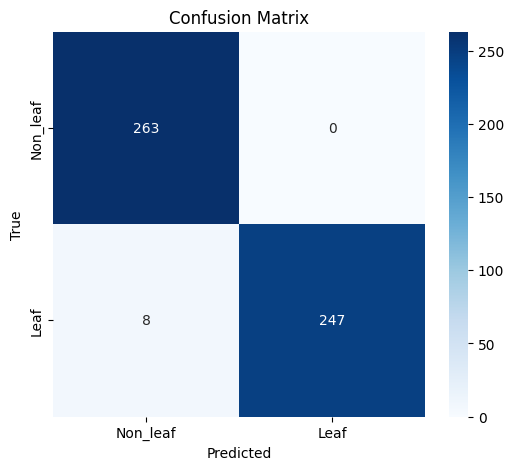


Classification Report:

              precision    recall  f1-score   support

    Non_leaf       0.97      1.00      0.99       263
        Leaf       1.00      0.97      0.98       255

    accuracy                           0.98       518
   macro avg       0.99      0.98      0.98       518
weighted avg       0.99      0.98      0.98       518



In [22]:
# ---------- 11) EVALUATE ON TEST SET ----------
test_loss, test_acc, test_prec, test_rec, test_auc = model.evaluate(test_gen, verbose=0)
print(f"\nTest Accuracy: {test_acc*100:.2f}%")
print(f"Precision: {test_prec:.4f}, Recall: {test_rec:.4f}, AUC: {test_auc:.4f}")
f1 = (2 * test_prec * test_rec) / (test_prec + test_rec) if (test_prec+test_rec)>0 else 0.0
print(f"F1-Score: {f1:.4f}")

# Confusion matrix & classification report
test_gen.reset()
y_true = test_gen.classes
y_probs = model.predict(test_gen, verbose=0)
y_pred = (y_probs > 0.5).astype(int).flatten()

cm = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues",
            xticklabels=["Non_leaf","Leaf"], yticklabels=["Non_leaf","Leaf"])
plt.xlabel("Predicted"); plt.ylabel("True"); plt.title("Confusion Matrix")
plt.show()

print("\nClassification Report:\n")
print(classification_report(y_true, y_pred, target_names=["Non_leaf","Leaf"]))


In [ ]:
# ---------- 12) SAVE FINAL MODEL (already saved best with ModelCheckpoint) ----------
FINAL_PATH = "/content/final_leaf_model.keras"
model.save(FINAL_PATH)
print(f"\nSaved final model to: {FINAL_PATH}")
print(f"Best model path (checkpoint): {BEST_PATH}")

# Optionally download the checkpoint or final model (uncomment if needed)
from google.colab import files
files.download(BEST_PATH)
files.download(FINAL_PATH)

In [24]:
# ---------- 13) RANDOM IMAGE PREDICTION TESTER (with confidence %) ----------
from tensorflow.keras.preprocessing  import image as kimage
def predict_random_from_test(model, split_dir=SPLIT_DIR, img_size=IMG_SIZE):
    test_root = split_dir / "test"
    classes = [p.name for p in test_root.iterdir() if p.is_dir()]
    chosen_class = random.choice(classes)
    imgs = list((test_root / chosen_class).glob("*"))
    if not imgs:
        print("No images found in test set for class:", chosen_class)
        return
    img_path = random.choice(imgs)
    img = kimage.load_img(img_path, target_size=img_size)
    arr = kimage.img_to_array(img) / 255.0
    arr = np.expand_dims(arr, axis=0)
    prob = model.predict(arr)[0][0]
    pred_label = "Non_leaf" if prob > 0.5 else "Leaf"
    confidence = prob if prob > 0.5 else 1-prob
    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Predicted: {pred_label} ({confidence*100:.2f}%)\nActual: {chosen_class}")
    plt.show()
    print("Image:", img_path)
    print(f"Predicted: {pred_label} ({confidence*100:.2f}%) | Actual: {chosen_class}")



1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


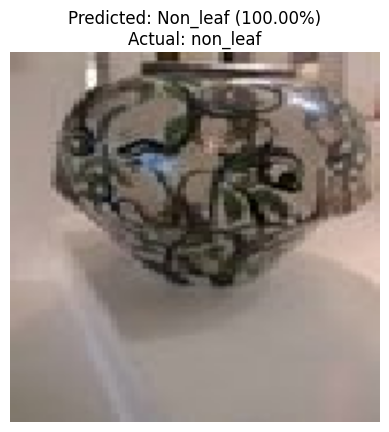

Image: /content/dataset/split/test/non_leaf/image1847.jpg
Predicted: Non_leaf (100.00%) | Actual: non_leaf


In [25]:
predict_random_from_test(model)

In [ ]:
print("Class mapping:", train_ds.class_names)

In [28]:
# ---------- CHECK EACH AND EVERY IMAGE FROM TEST SET ----------
from tensorflow.keras.preprocessing import image as kimage
import matplotlib.pyplot as plt
import numpy as np
import random
from pathlib import Path

def predict_all_from_test(model, split_dir=SPLIT_DIR, img_size=IMG_SIZE):
    test_root = Path(split_dir) / "test"
    classes = [p.name for p in test_root.iterdir() if p.is_dir()]

    total, correct = 0, 0

    for actual_class in classes:
        imgs = list((test_root / actual_class).glob("*"))
        if not imgs:
            print(f"No images found for class: {actual_class}")
            continue

        print(f"\n=== Checking images in class: {actual_class} ===")

        for img_path in imgs:
            # Load and preprocess image
            img = kimage.load_img(img_path, target_size=img_size)
            arr = kimage.img_to_array(img) / 255.0
            arr = np.expand_dims(arr, axis=0)

            # Predict
            prob = model.predict(arr, verbose=0)[0][0]
            pred_label = "non_leaf" if prob > 0.5 else "leaf"
            confidence = prob if prob > 0.5 else 1 - prob

            total += 1
            if pred_label.lower() == actual_class.lower():
                correct += 1

            # Show image with prediction (optional)
            plt.imshow(img)
            plt.axis("off")
            plt.title(f"Predicted: {pred_label} ({confidence*100:.2f}%)\nActual: {actual_class}")
            plt.show()

            print(f"Image: {img_path.name}")
            print(f"Predicted: {pred_label} ({confidence*100:.2f}%) | Actual: {actual_class}")
            print("-" * 50)

    accuracy = (correct / total) * 100 if total > 0 else 0
    print(f"\n✅ Overall Test Accuracy (based on prediction loop): {accuracy:.2f}% ({correct}/{total})")



=== Checking images in class: non_leaf ===


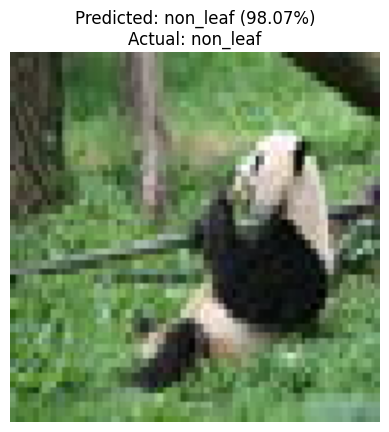

Image: image1444.jpg
Predicted: non_leaf (98.07%) | Actual: non_leaf
--------------------------------------------------


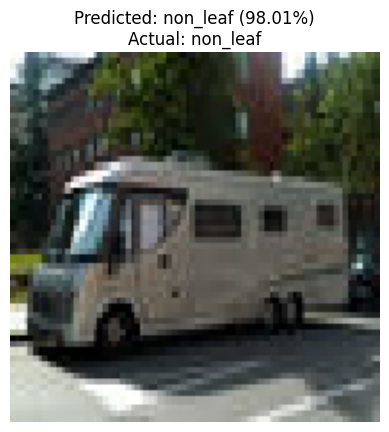

Image: image1630.jpg
Predicted: non_leaf (98.01%) | Actual: non_leaf
--------------------------------------------------


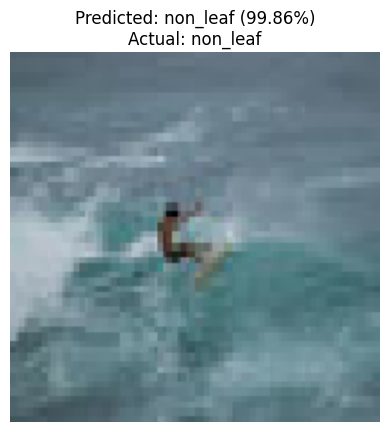

Image: image1609.jpg
Predicted: non_leaf (99.86%) | Actual: non_leaf
--------------------------------------------------


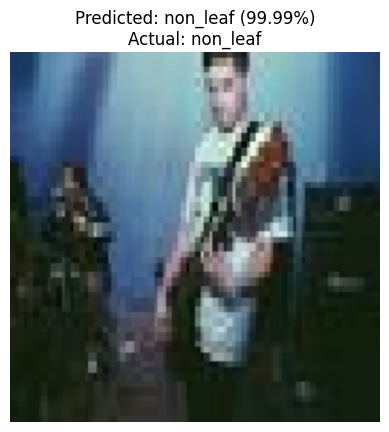

Image: image2089.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


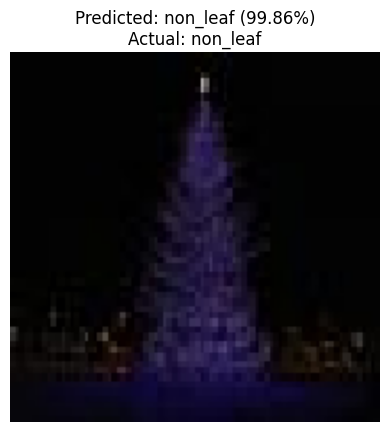

Image: image1475.jpg
Predicted: non_leaf (99.86%) | Actual: non_leaf
--------------------------------------------------


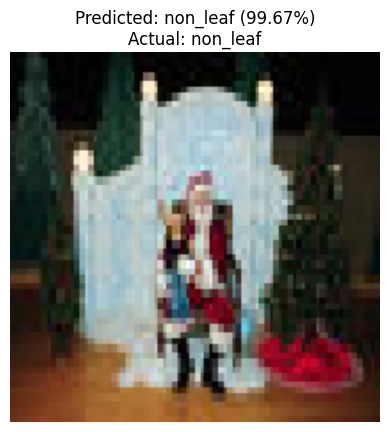

Image: image1272.jpg
Predicted: non_leaf (99.67%) | Actual: non_leaf
--------------------------------------------------


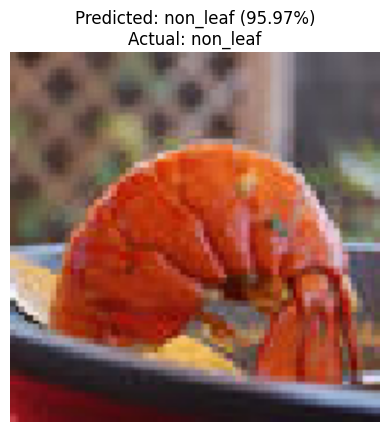

Image: image1237.jpg
Predicted: non_leaf (95.97%) | Actual: non_leaf
--------------------------------------------------


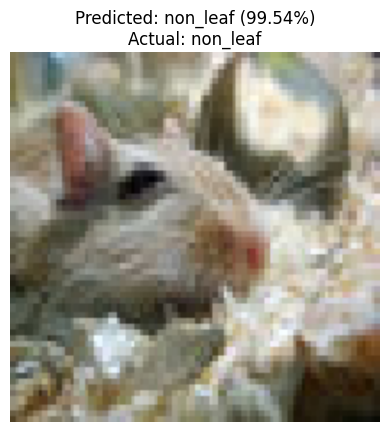

Image: image2856.jpg
Predicted: non_leaf (99.54%) | Actual: non_leaf
--------------------------------------------------


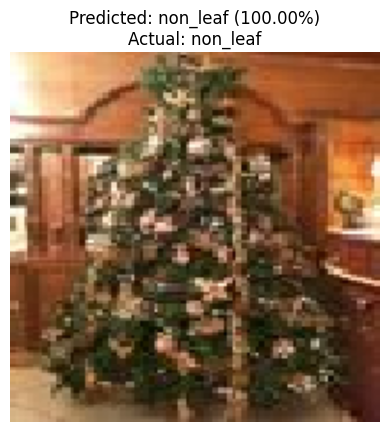

Image: image2322.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


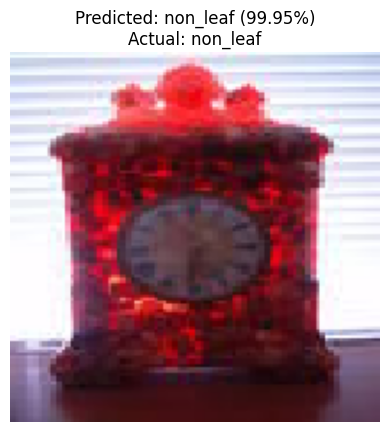

Image: image1922.jpg
Predicted: non_leaf (99.95%) | Actual: non_leaf
--------------------------------------------------


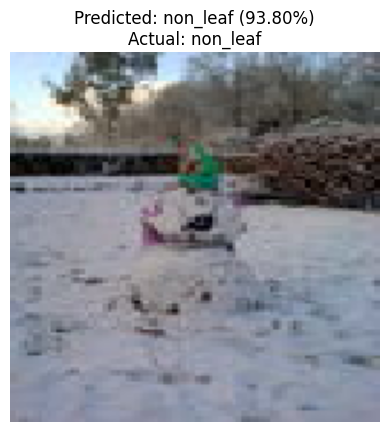

Image: image1579.jpg
Predicted: non_leaf (93.80%) | Actual: non_leaf
--------------------------------------------------


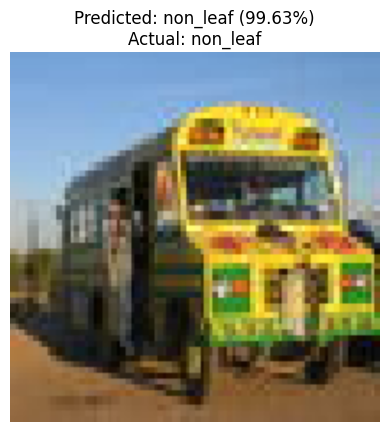

Image: image1685.jpg
Predicted: non_leaf (99.63%) | Actual: non_leaf
--------------------------------------------------


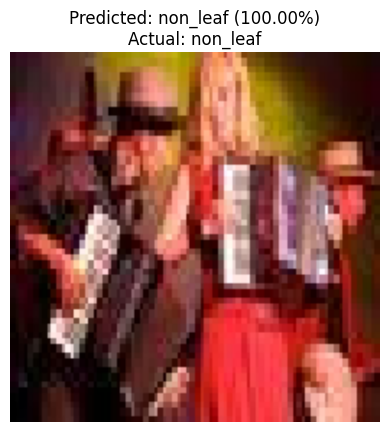

Image: image2409.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


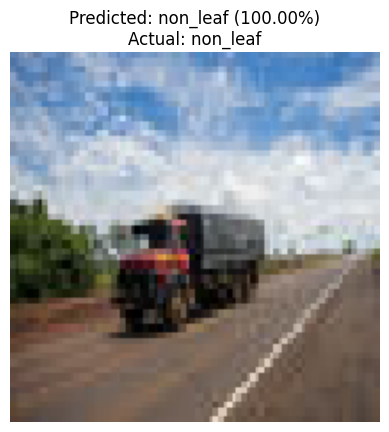

Image: image1731.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


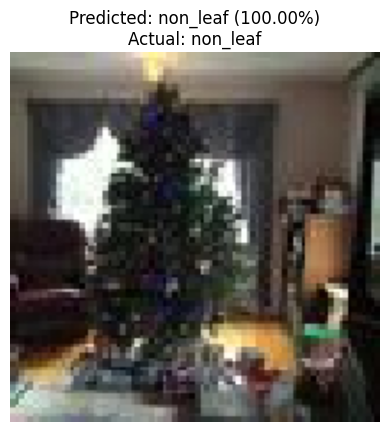

Image: image1792.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


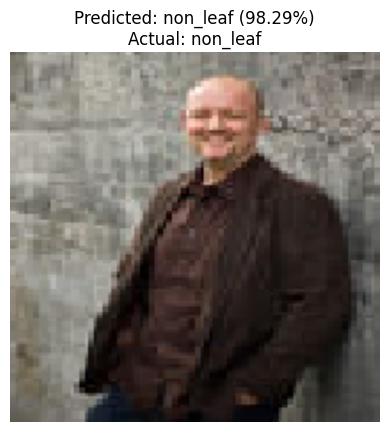

Image: image1777.jpg
Predicted: non_leaf (98.29%) | Actual: non_leaf
--------------------------------------------------


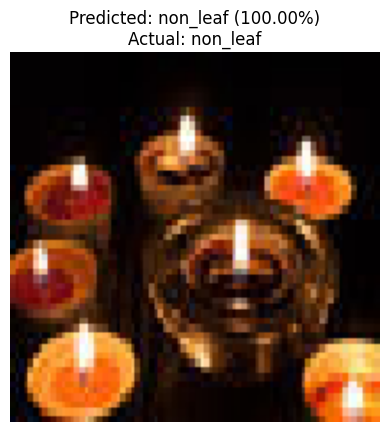

Image: image2277.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


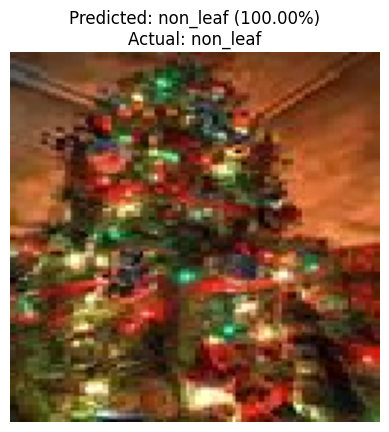

Image: image2345.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


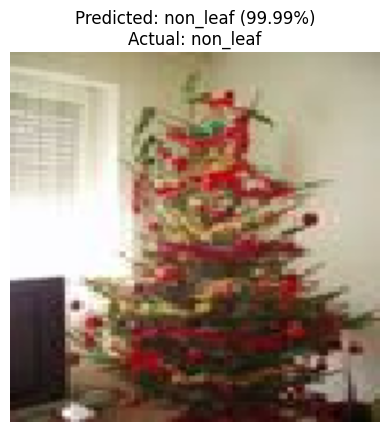

Image: image1225.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


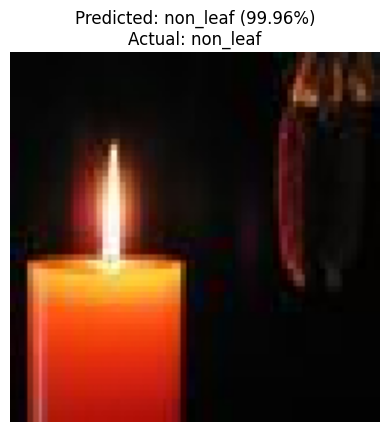

Image: image1290.jpg
Predicted: non_leaf (99.96%) | Actual: non_leaf
--------------------------------------------------


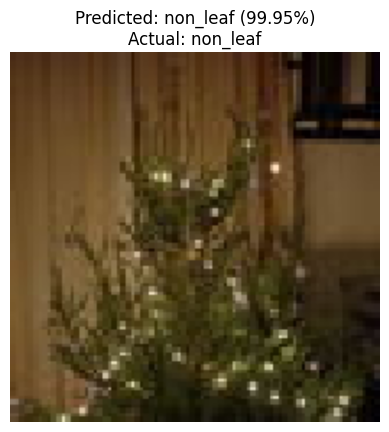

Image: image2673.jpg
Predicted: non_leaf (99.95%) | Actual: non_leaf
--------------------------------------------------


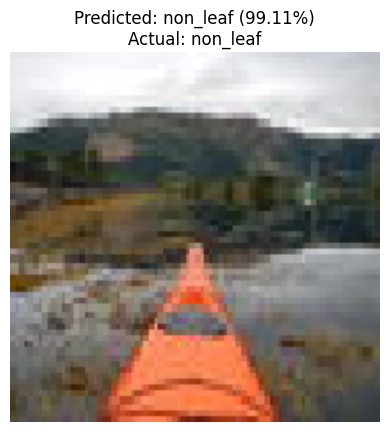

Image: image2682.jpg
Predicted: non_leaf (99.11%) | Actual: non_leaf
--------------------------------------------------


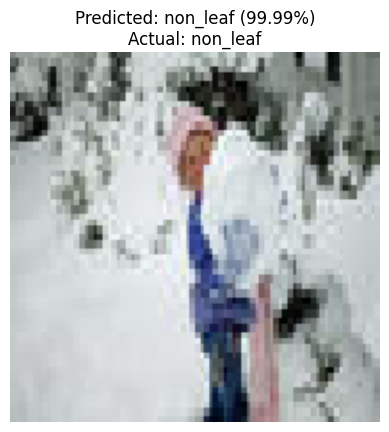

Image: image2996.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


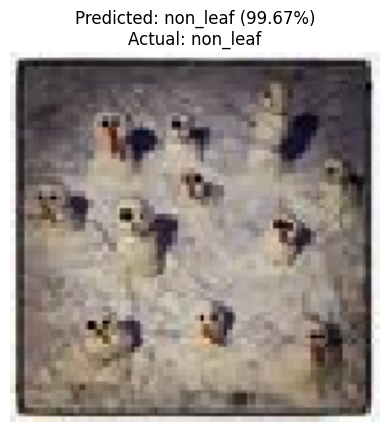

Image: image2430.jpg
Predicted: non_leaf (99.67%) | Actual: non_leaf
--------------------------------------------------


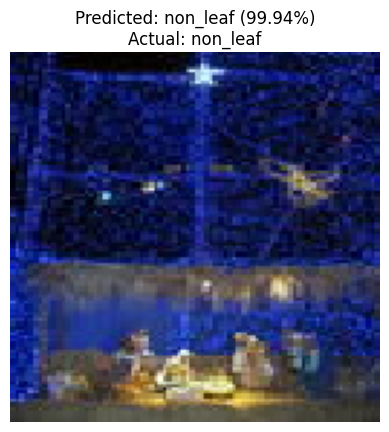

Image: image1948.jpg
Predicted: non_leaf (99.94%) | Actual: non_leaf
--------------------------------------------------


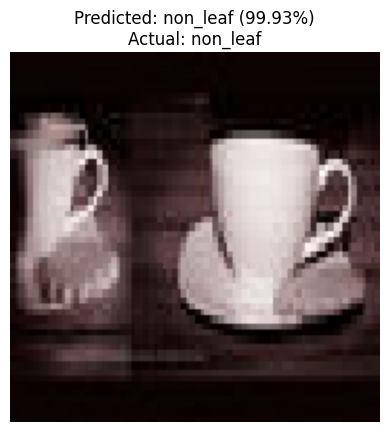

Image: image2320.jpg
Predicted: non_leaf (99.93%) | Actual: non_leaf
--------------------------------------------------


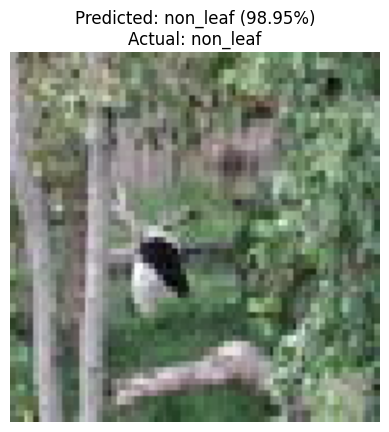

Image: image1368.jpg
Predicted: non_leaf (98.95%) | Actual: non_leaf
--------------------------------------------------


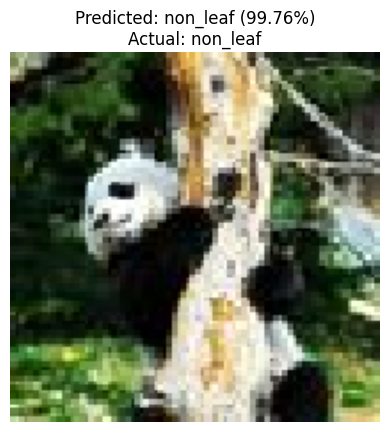

Image: image2500.jpg
Predicted: non_leaf (99.76%) | Actual: non_leaf
--------------------------------------------------


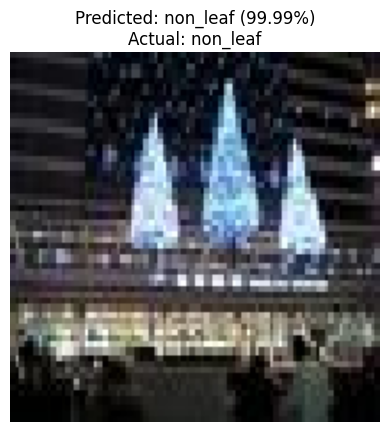

Image: image2868.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


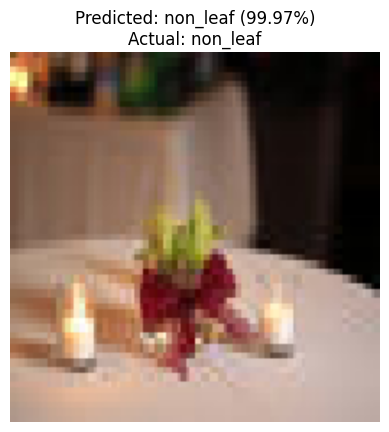

Image: image2408.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


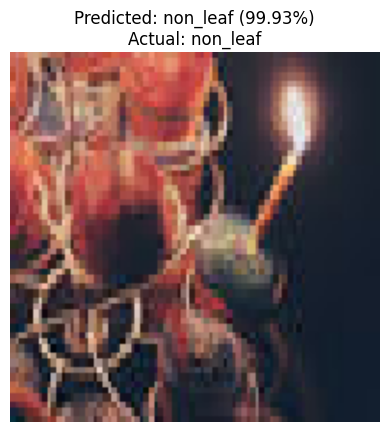

Image: image1443.jpg
Predicted: non_leaf (99.93%) | Actual: non_leaf
--------------------------------------------------


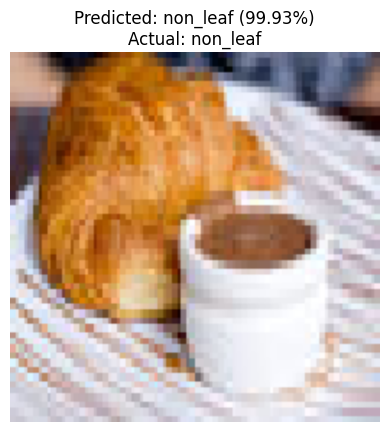

Image: image1718.jpg
Predicted: non_leaf (99.93%) | Actual: non_leaf
--------------------------------------------------


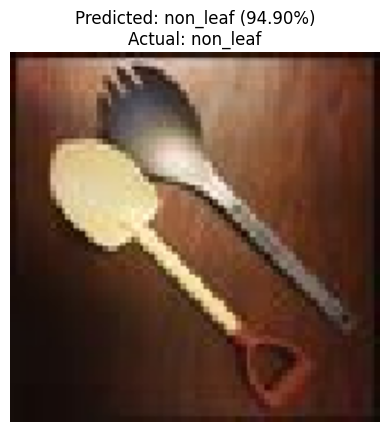

Image: image1359.jpg
Predicted: non_leaf (94.90%) | Actual: non_leaf
--------------------------------------------------


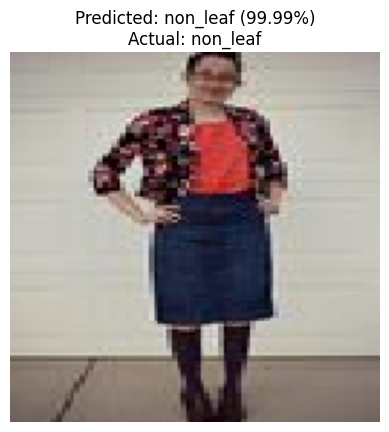

Image: image1317.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


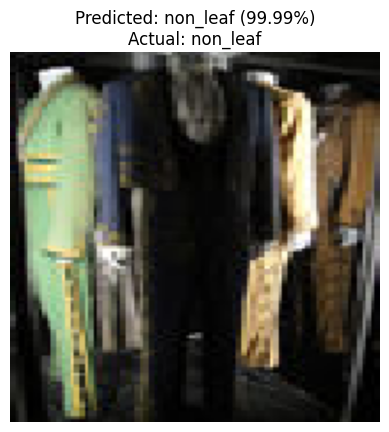

Image: image1629.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


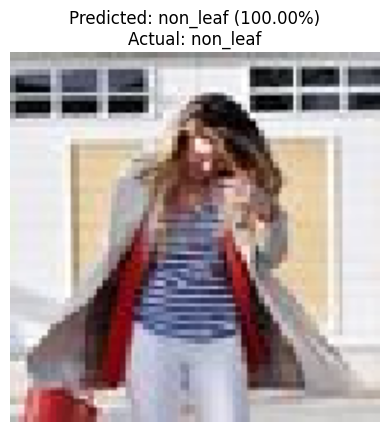

Image: image2249.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


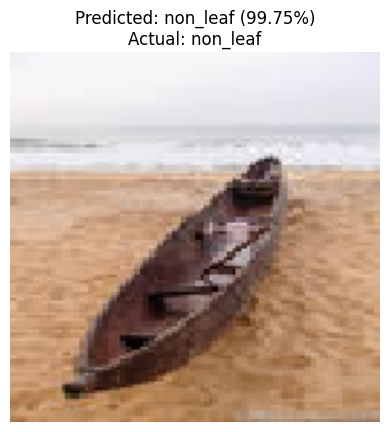

Image: image1838.jpg
Predicted: non_leaf (99.75%) | Actual: non_leaf
--------------------------------------------------


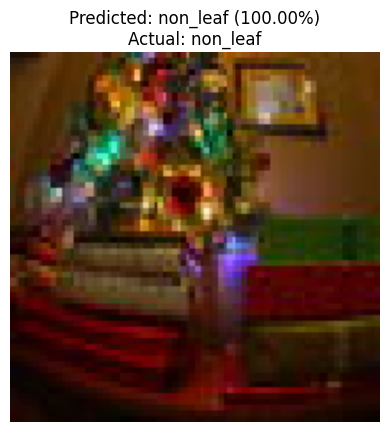

Image: image1917.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


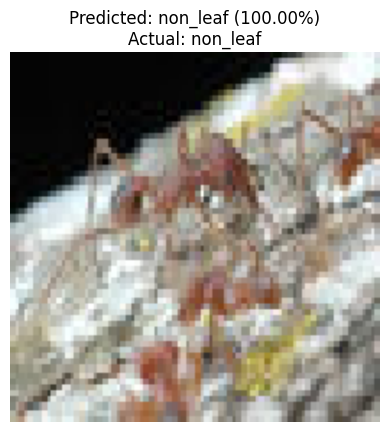

Image: image1899.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


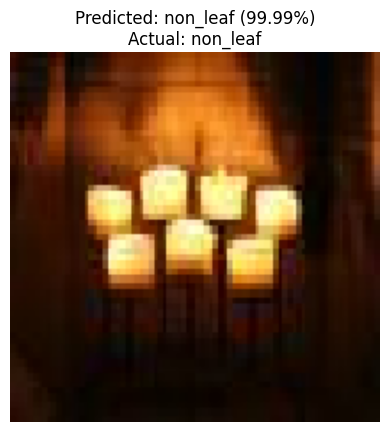

Image: image1708.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


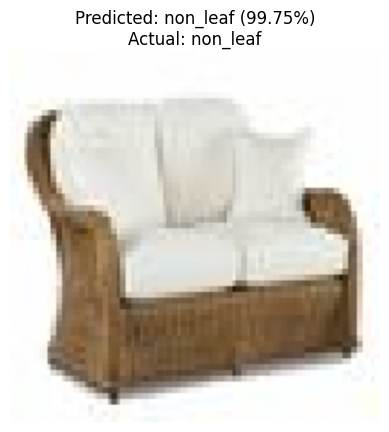

Image: image2289.jpg
Predicted: non_leaf (99.75%) | Actual: non_leaf
--------------------------------------------------


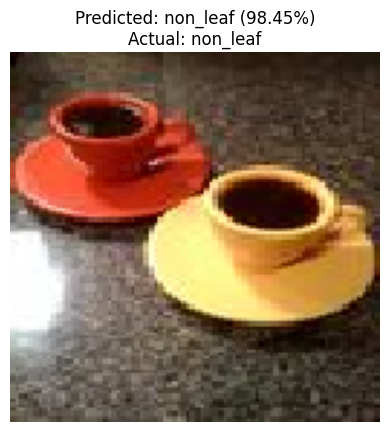

Image: image2225.jpg
Predicted: non_leaf (98.45%) | Actual: non_leaf
--------------------------------------------------


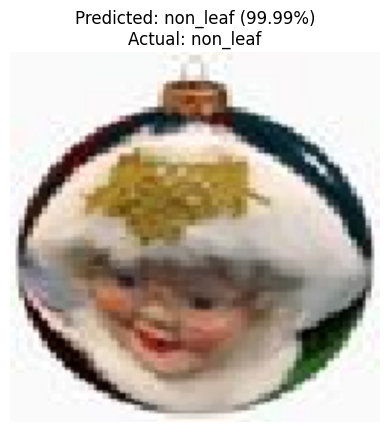

Image: image1402.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


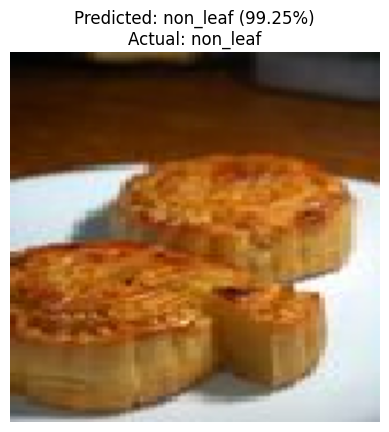

Image: image1217.jpg
Predicted: non_leaf (99.25%) | Actual: non_leaf
--------------------------------------------------


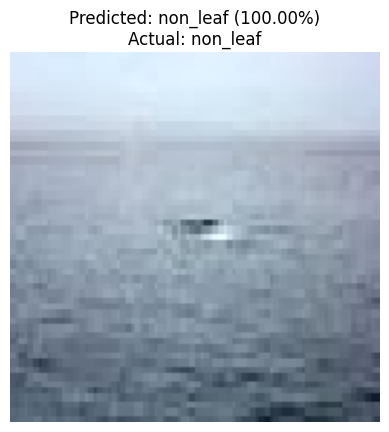

Image: image1652.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


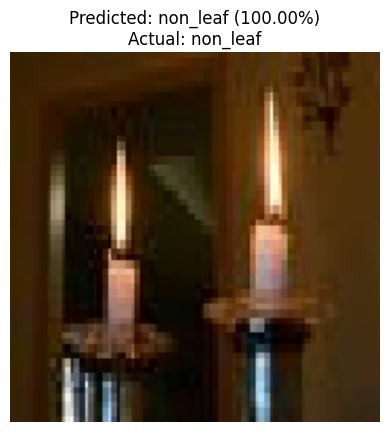

Image: image1453.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


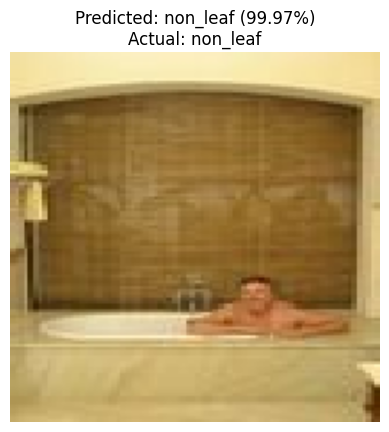

Image: image1618.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


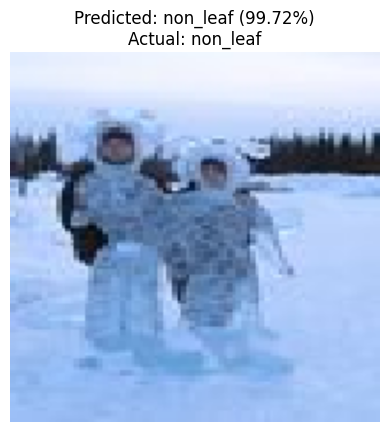

Image: image2219.jpg
Predicted: non_leaf (99.72%) | Actual: non_leaf
--------------------------------------------------


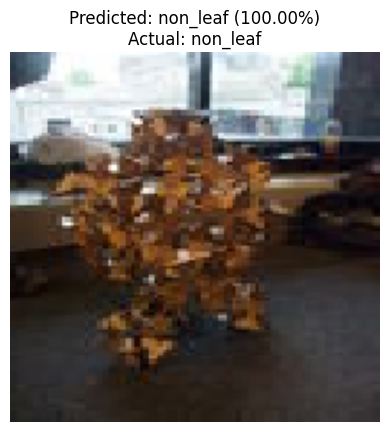

Image: image1169.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


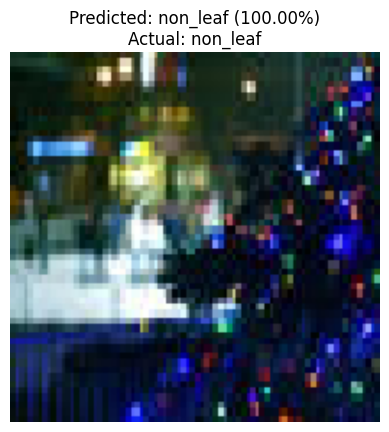

Image: image2228.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


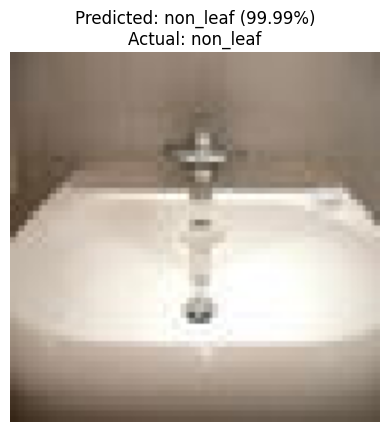

Image: image1446.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


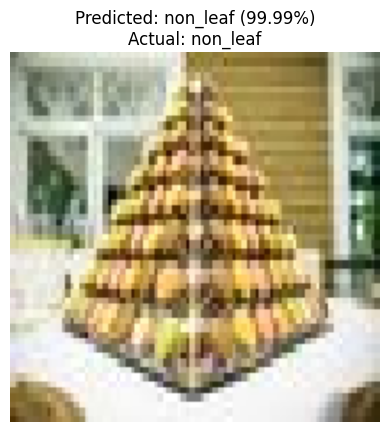

Image: image1500.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


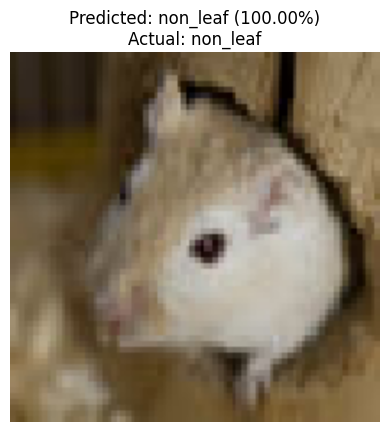

Image: image2840.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


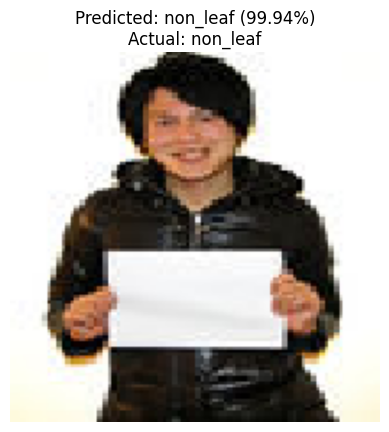

Image: image2411.jpg
Predicted: non_leaf (99.94%) | Actual: non_leaf
--------------------------------------------------


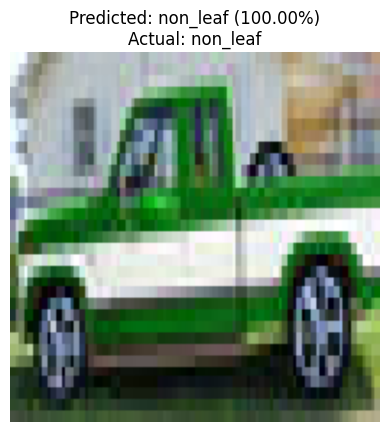

Image: image1190.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


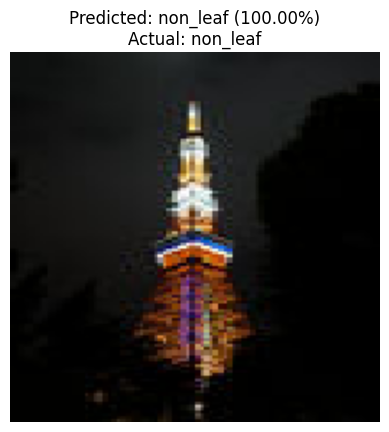

Image: image2209.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


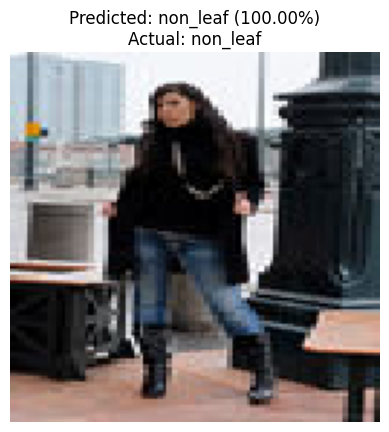

Image: image1911.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


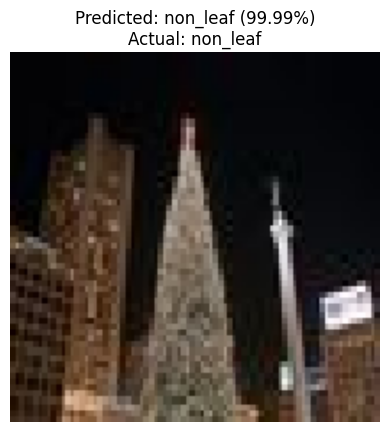

Image: image1412.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


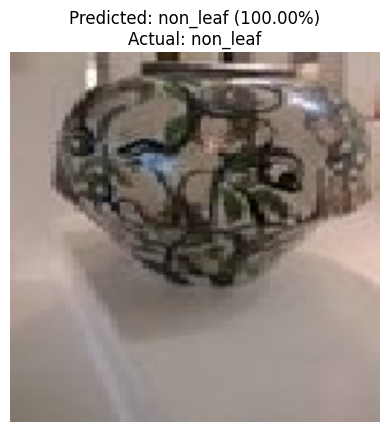

Image: image1847.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


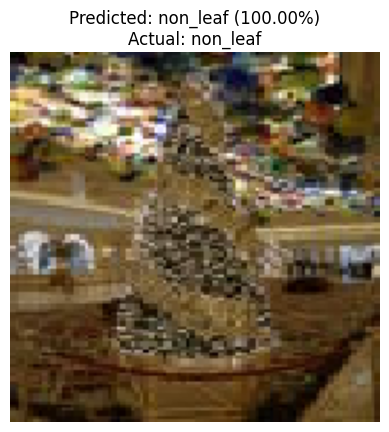

Image: image2039.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


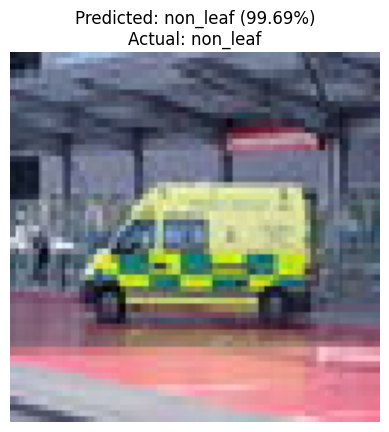

Image: image2887.jpg
Predicted: non_leaf (99.69%) | Actual: non_leaf
--------------------------------------------------


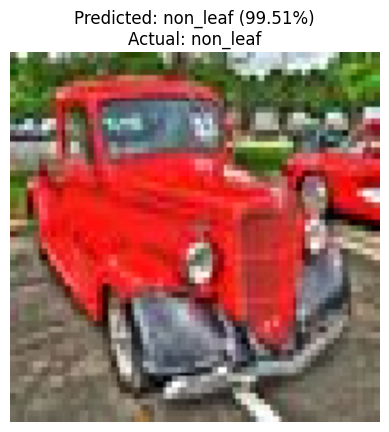

Image: image1329.jpg
Predicted: non_leaf (99.51%) | Actual: non_leaf
--------------------------------------------------


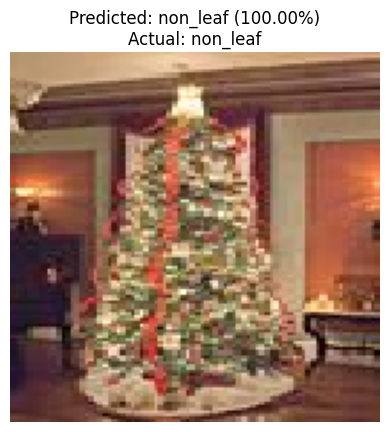

Image: image1988.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


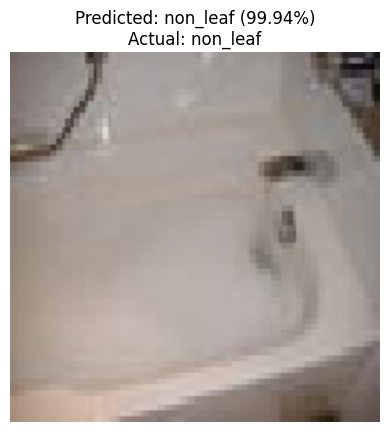

Image: image1981.jpg
Predicted: non_leaf (99.94%) | Actual: non_leaf
--------------------------------------------------


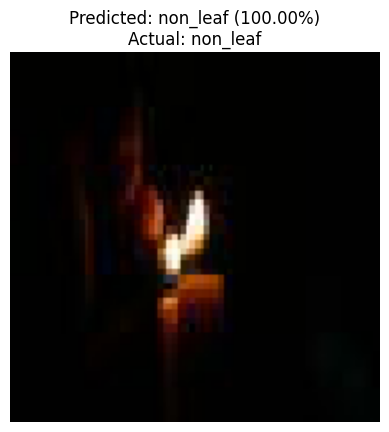

Image: image2369.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


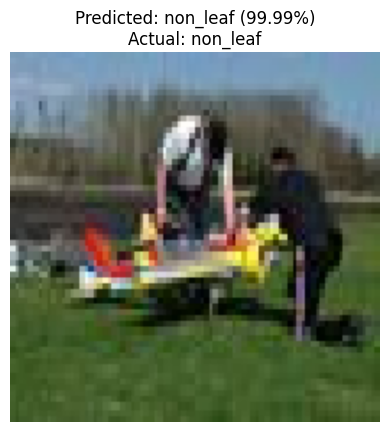

Image: image2368.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


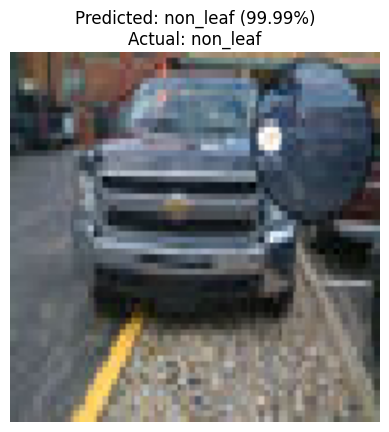

Image: image2309.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


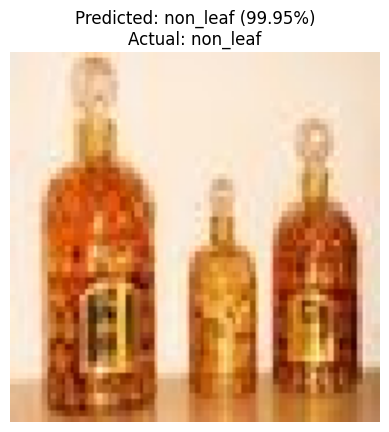

Image: image2188.jpg
Predicted: non_leaf (99.95%) | Actual: non_leaf
--------------------------------------------------


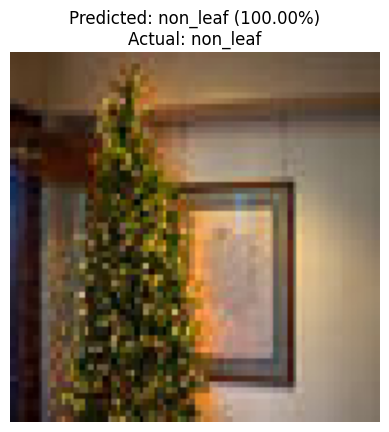

Image: image1558.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


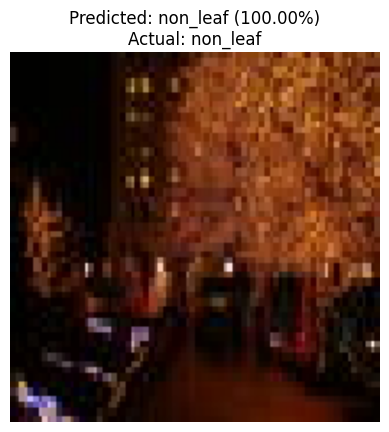

Image: image1675.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


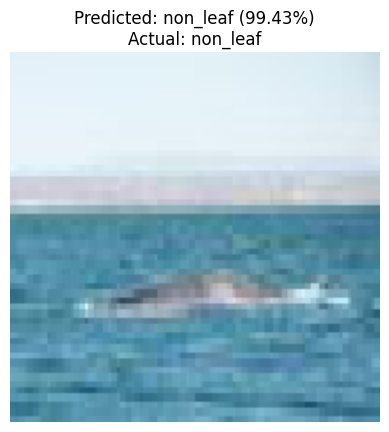

Image: image1436.jpg
Predicted: non_leaf (99.43%) | Actual: non_leaf
--------------------------------------------------


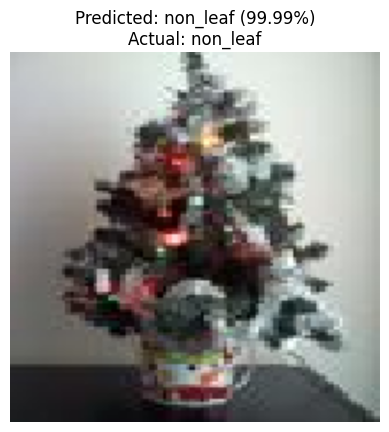

Image: image3090.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


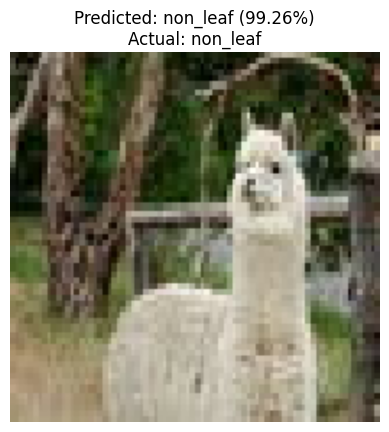

Image: image2666.jpg
Predicted: non_leaf (99.26%) | Actual: non_leaf
--------------------------------------------------


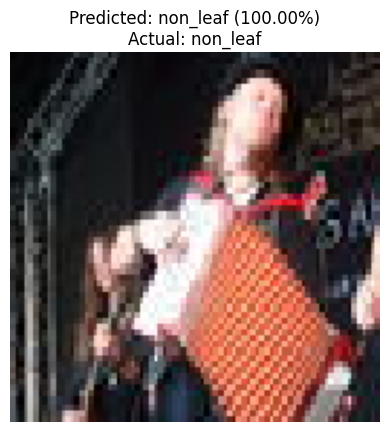

Image: image2155.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


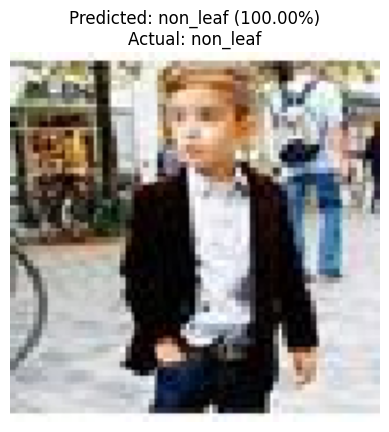

Image: image2646.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


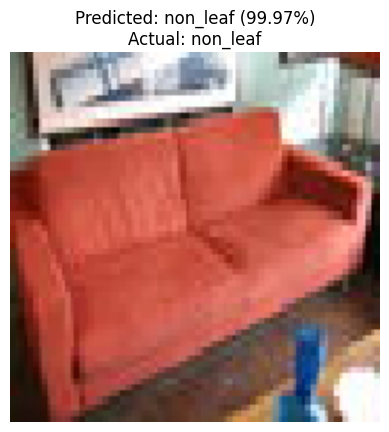

Image: image2486.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


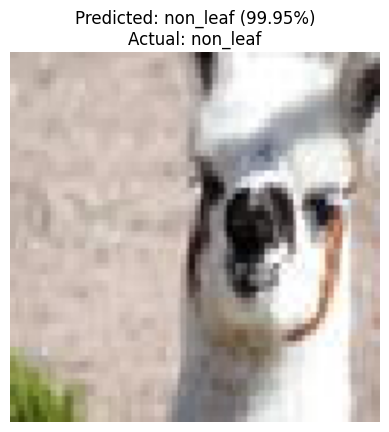

Image: image1341.jpg
Predicted: non_leaf (99.95%) | Actual: non_leaf
--------------------------------------------------


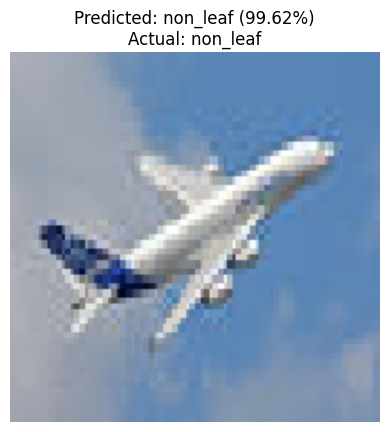

Image: image1883.jpg
Predicted: non_leaf (99.62%) | Actual: non_leaf
--------------------------------------------------


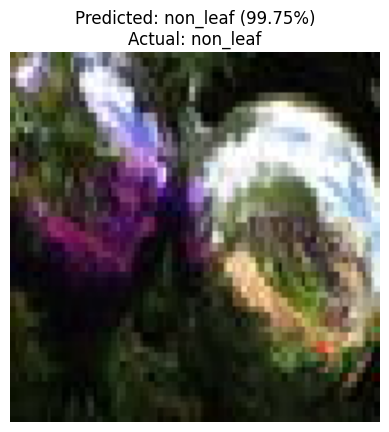

Image: image2830.jpg
Predicted: non_leaf (99.75%) | Actual: non_leaf
--------------------------------------------------


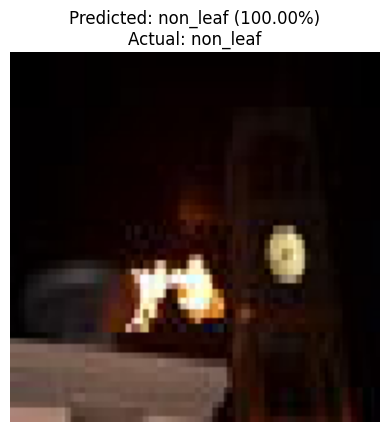

Image: image1477.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


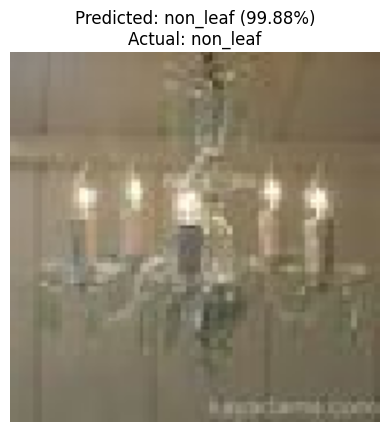

Image: image2504.jpg
Predicted: non_leaf (99.88%) | Actual: non_leaf
--------------------------------------------------


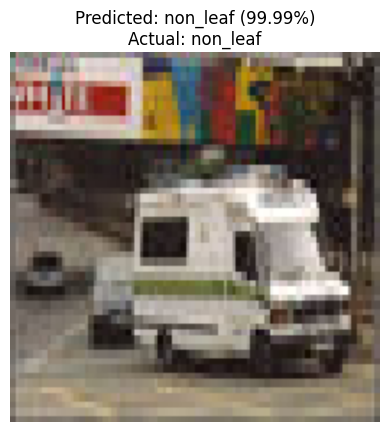

Image: image1381.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


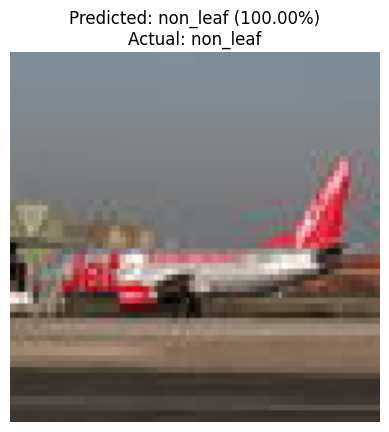

Image: image2237.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


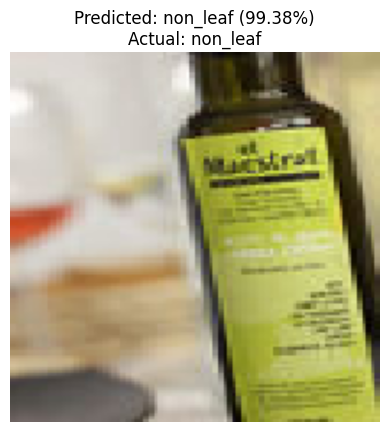

Image: image1518.jpg
Predicted: non_leaf (99.38%) | Actual: non_leaf
--------------------------------------------------


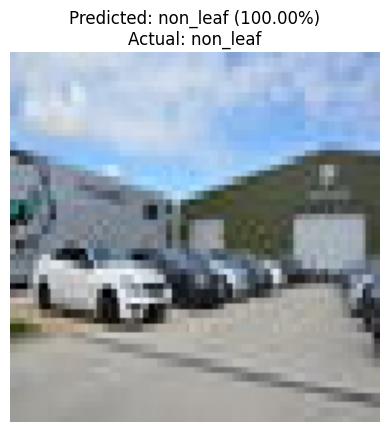

Image: image2414.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


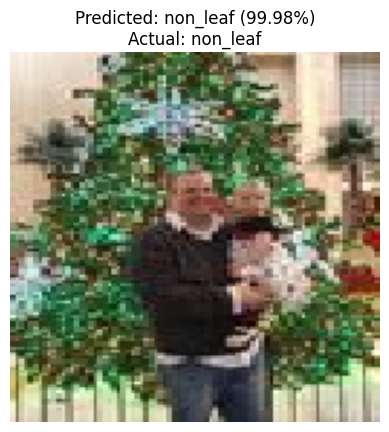

Image: image1509.jpg
Predicted: non_leaf (99.98%) | Actual: non_leaf
--------------------------------------------------


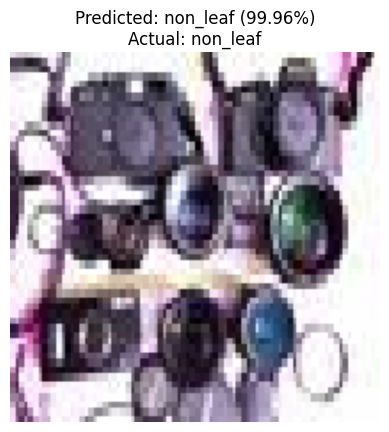

Image: image2886.jpg
Predicted: non_leaf (99.96%) | Actual: non_leaf
--------------------------------------------------


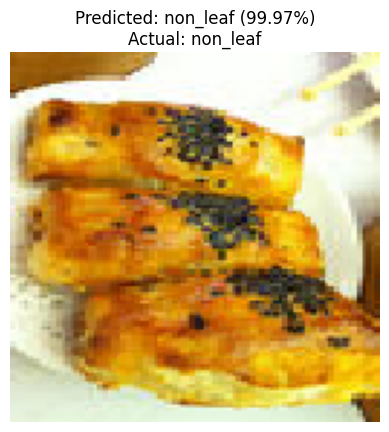

Image: image2448.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


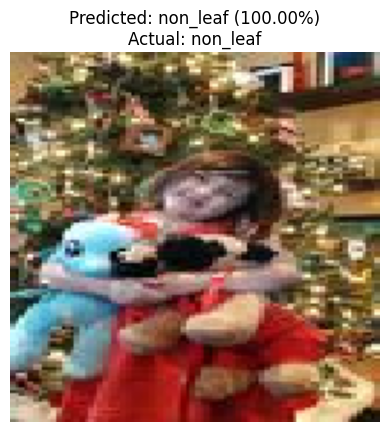

Image: image1595.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


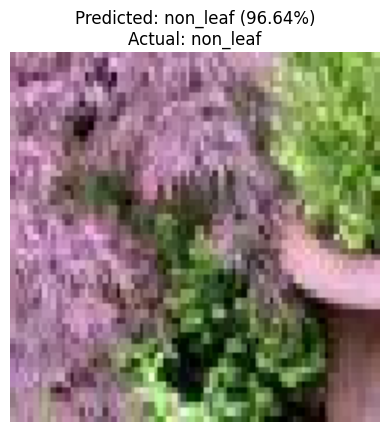

Image: image1640.jpg
Predicted: non_leaf (96.64%) | Actual: non_leaf
--------------------------------------------------


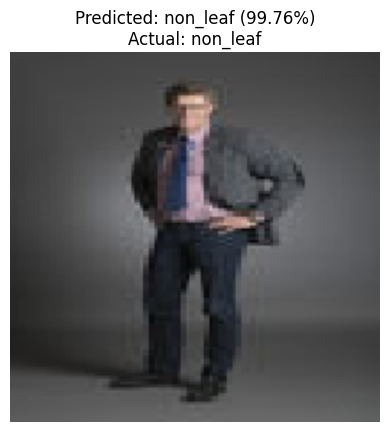

Image: image1254.jpg
Predicted: non_leaf (99.76%) | Actual: non_leaf
--------------------------------------------------


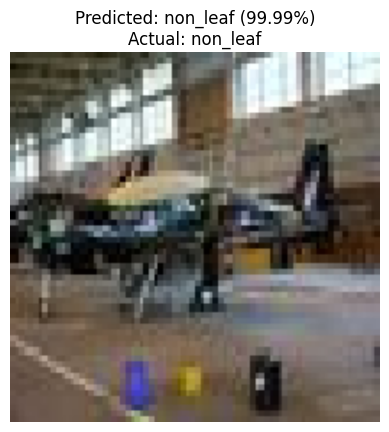

Image: image2720.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


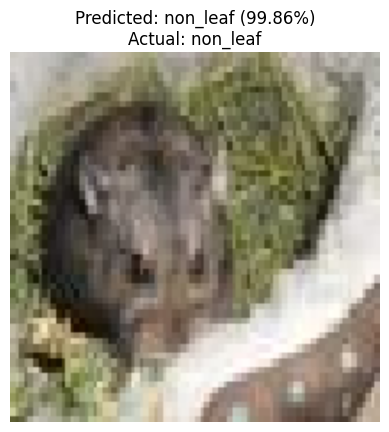

Image: image3167.jpg
Predicted: non_leaf (99.86%) | Actual: non_leaf
--------------------------------------------------


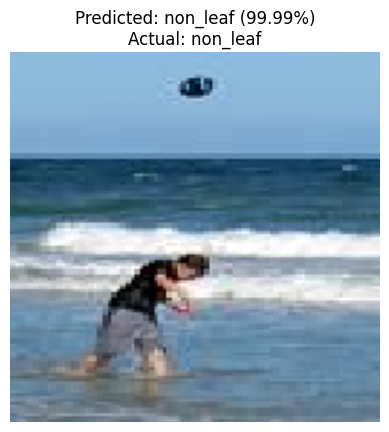

Image: image1080.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


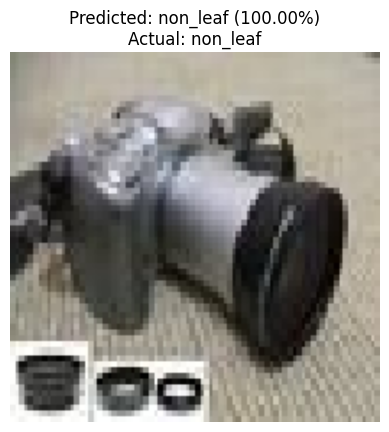

Image: image1510.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


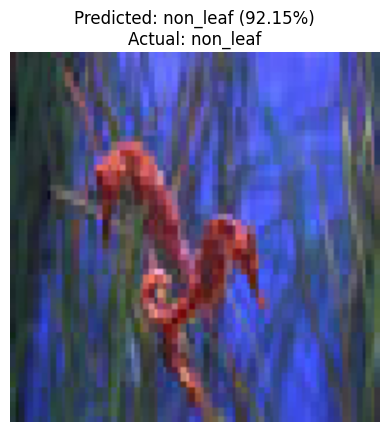

Image: image1966.jpg
Predicted: non_leaf (92.15%) | Actual: non_leaf
--------------------------------------------------


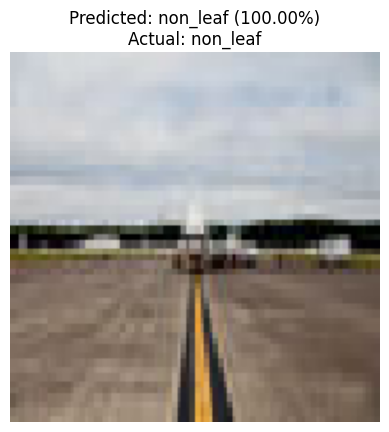

Image: image1321.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


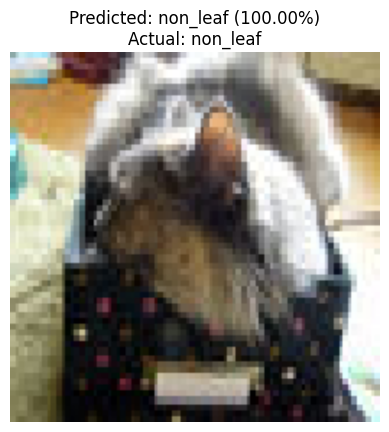

Image: image2982.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


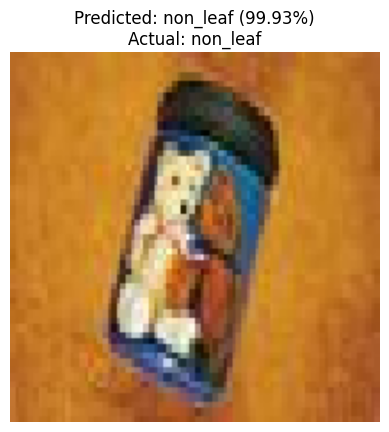

Image: image1819.jpg
Predicted: non_leaf (99.93%) | Actual: non_leaf
--------------------------------------------------


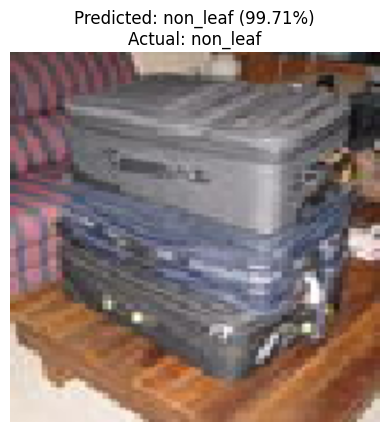

Image: image1292.jpg
Predicted: non_leaf (99.71%) | Actual: non_leaf
--------------------------------------------------


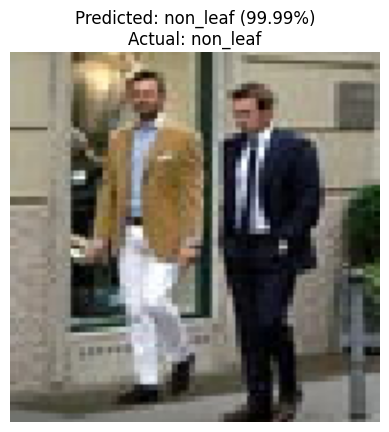

Image: image1445.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


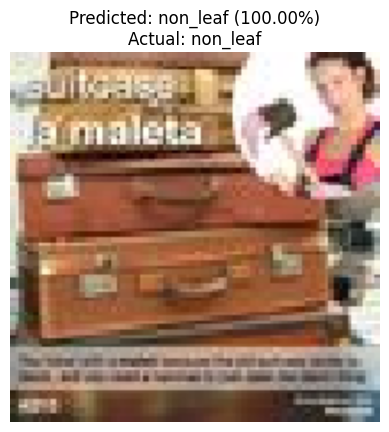

Image: image2562.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


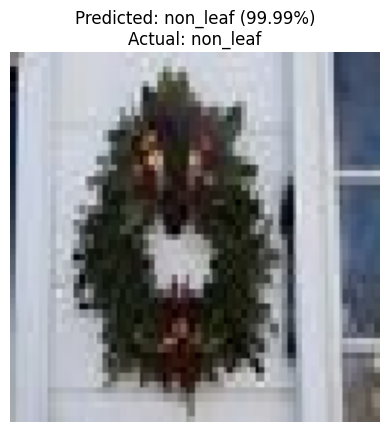

Image: image1635.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


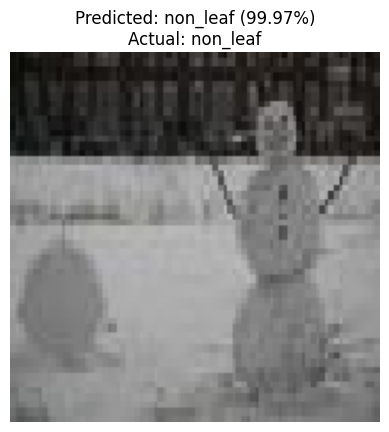

Image: image1151.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


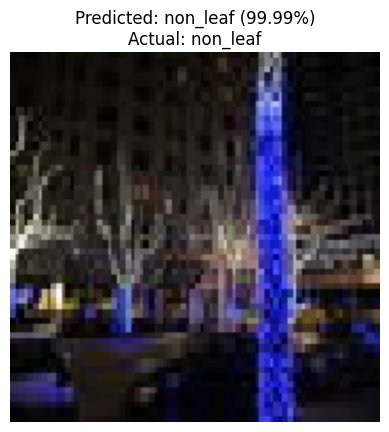

Image: image2509.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


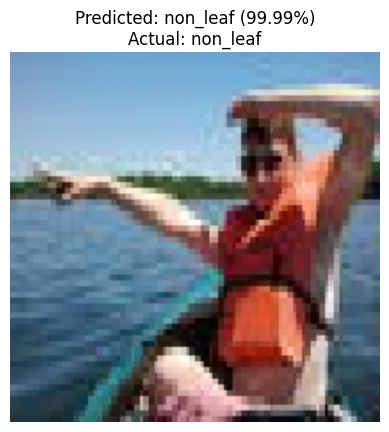

Image: image2095.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


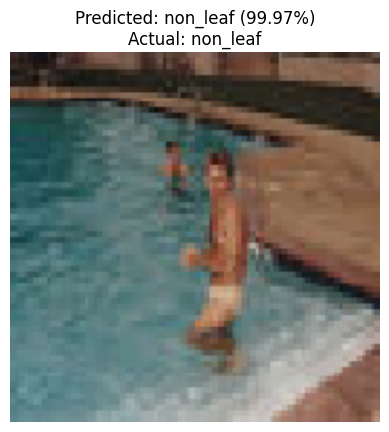

Image: image1953.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


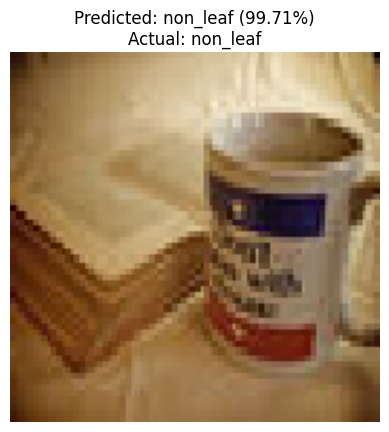

Image: image1787.jpg
Predicted: non_leaf (99.71%) | Actual: non_leaf
--------------------------------------------------


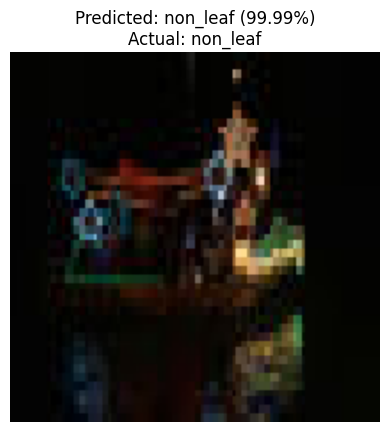

Image: image1746.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


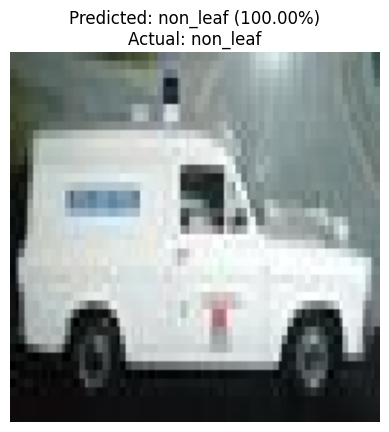

Image: image1416.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


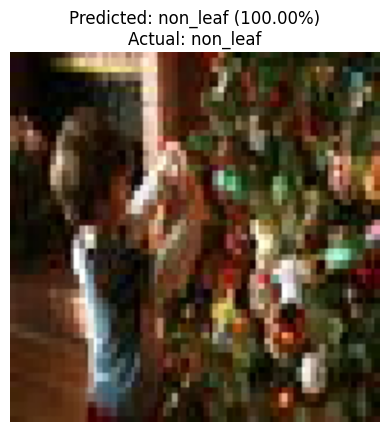

Image: image1180.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


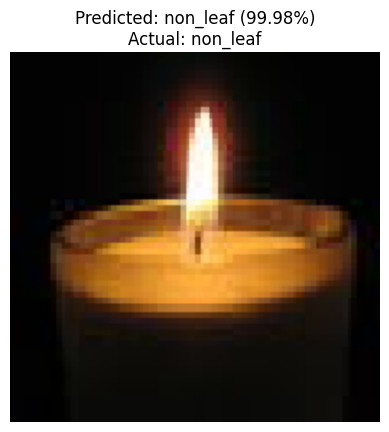

Image: image1459.jpg
Predicted: non_leaf (99.98%) | Actual: non_leaf
--------------------------------------------------


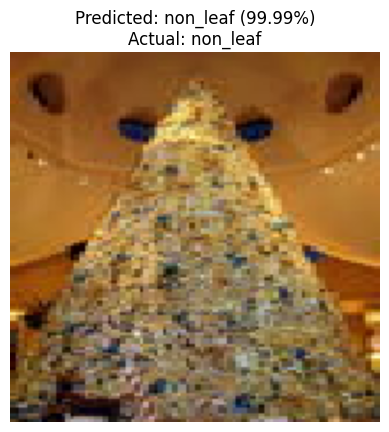

Image: image1334.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


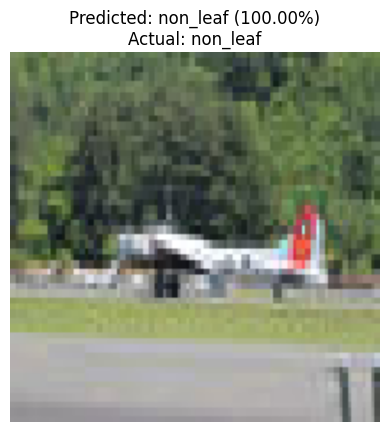

Image: image2235.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


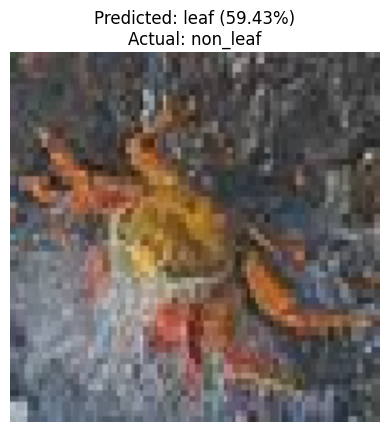

Image: image2308.jpg
Predicted: leaf (59.43%) | Actual: non_leaf
--------------------------------------------------


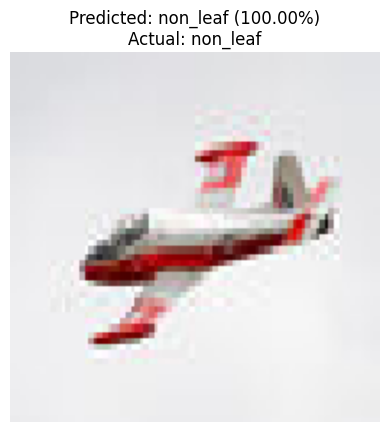

Image: image1345.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


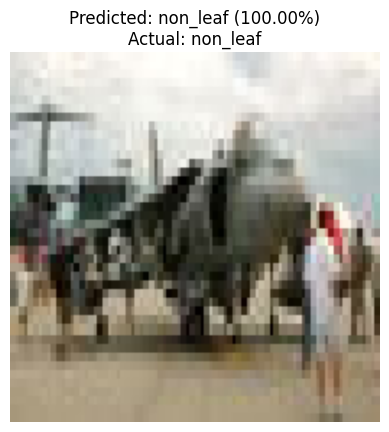

Image: image1240.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


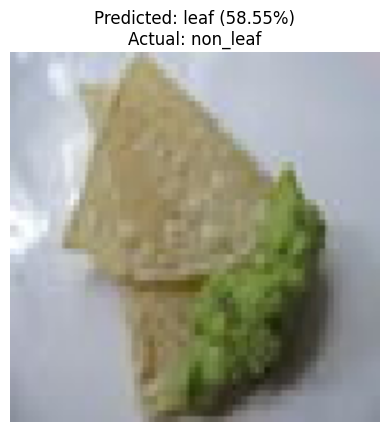

Image: image1565.jpg
Predicted: leaf (58.55%) | Actual: non_leaf
--------------------------------------------------


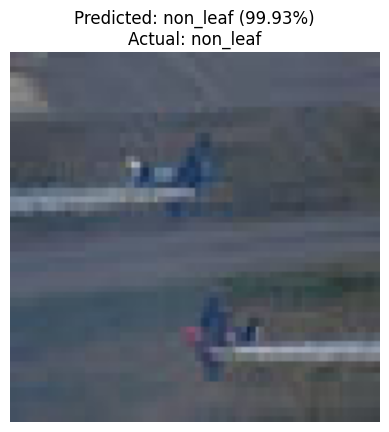

Image: image3027.jpg
Predicted: non_leaf (99.93%) | Actual: non_leaf
--------------------------------------------------


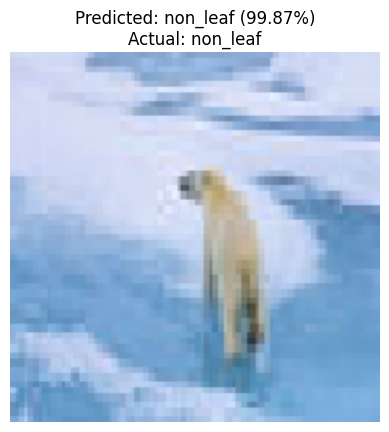

Image: image1252.jpg
Predicted: non_leaf (99.87%) | Actual: non_leaf
--------------------------------------------------


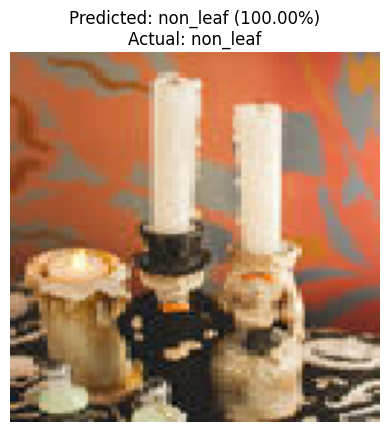

Image: image2889.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


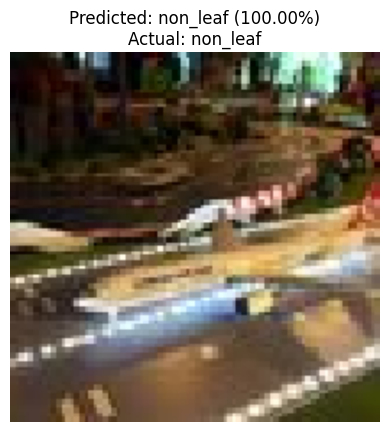

Image: image2482.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


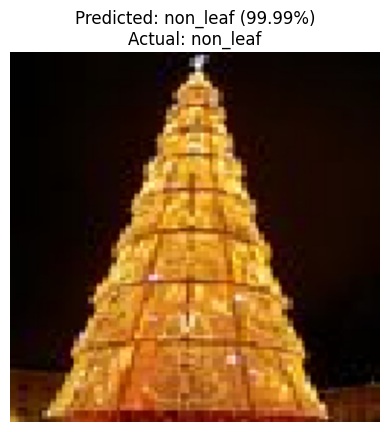

Image: image1555.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


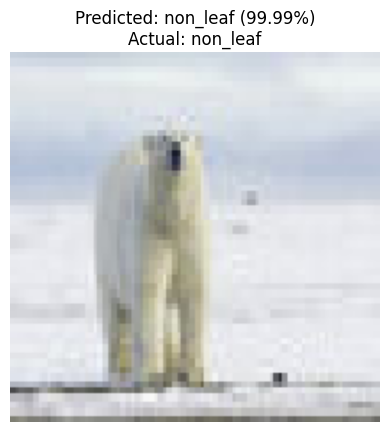

Image: image1399.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


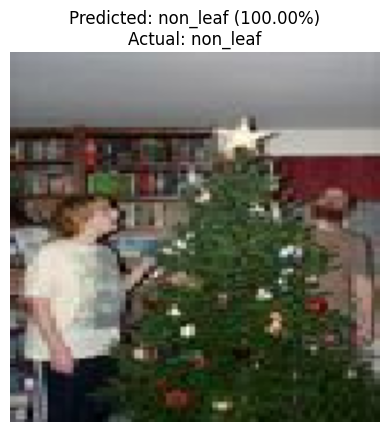

Image: image2367.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


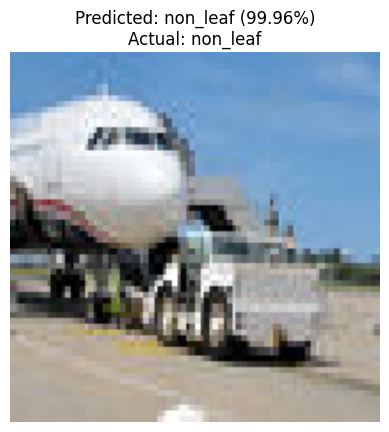

Image: image2162.jpg
Predicted: non_leaf (99.96%) | Actual: non_leaf
--------------------------------------------------


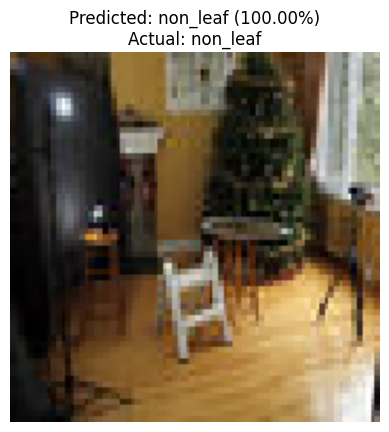

Image: image1284.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


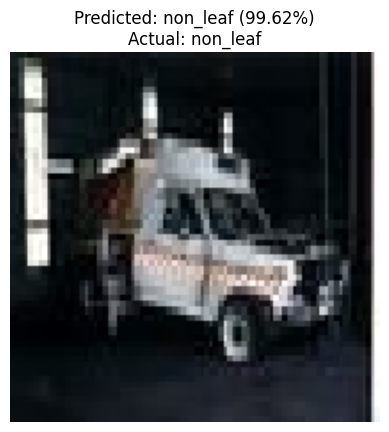

Image: image1258.jpg
Predicted: non_leaf (99.62%) | Actual: non_leaf
--------------------------------------------------


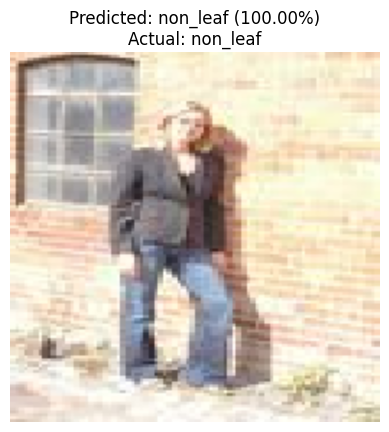

Image: image1684.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


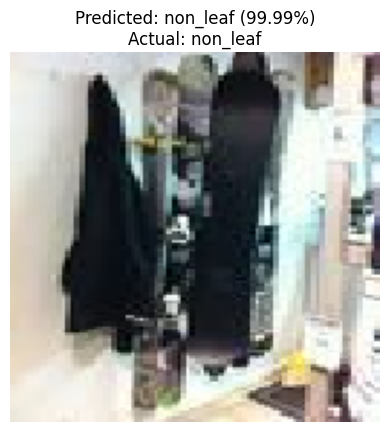

Image: image2282.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


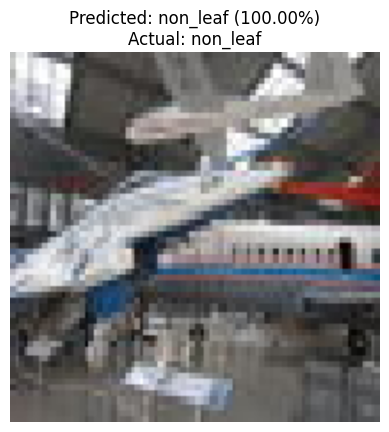

Image: image1554.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


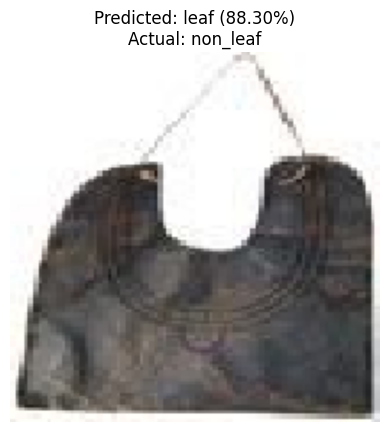

Image: image1122.jpg
Predicted: leaf (88.30%) | Actual: non_leaf
--------------------------------------------------


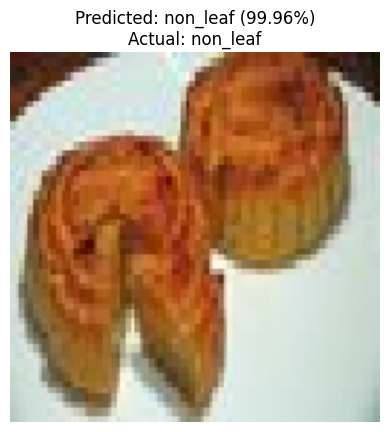

Image: image2900.jpg
Predicted: non_leaf (99.96%) | Actual: non_leaf
--------------------------------------------------


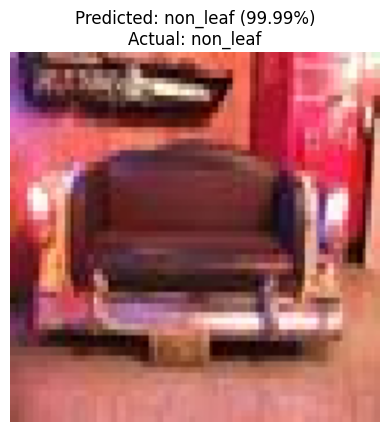

Image: image1612.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


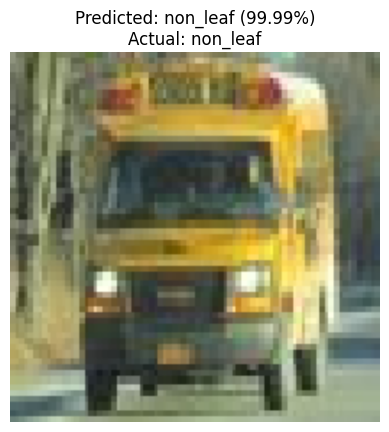

Image: image1426.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


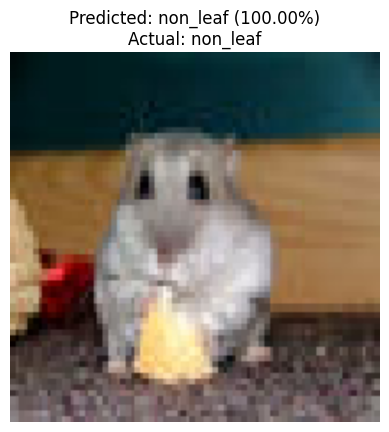

Image: image3001.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


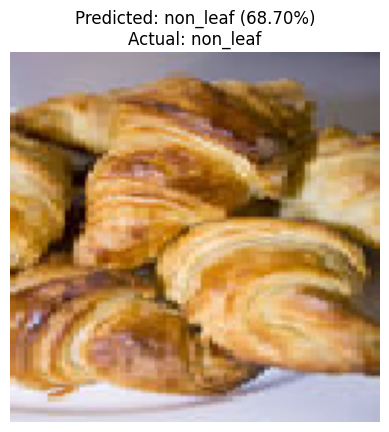

Image: image2696.jpg
Predicted: non_leaf (68.70%) | Actual: non_leaf
--------------------------------------------------


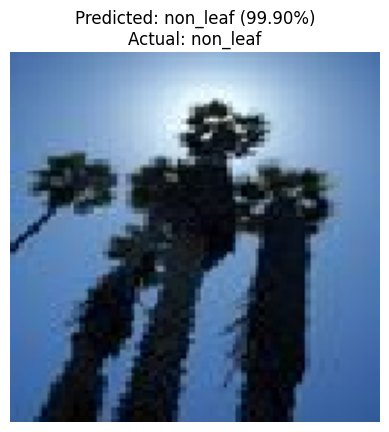

Image: image2454.jpg
Predicted: non_leaf (99.90%) | Actual: non_leaf
--------------------------------------------------


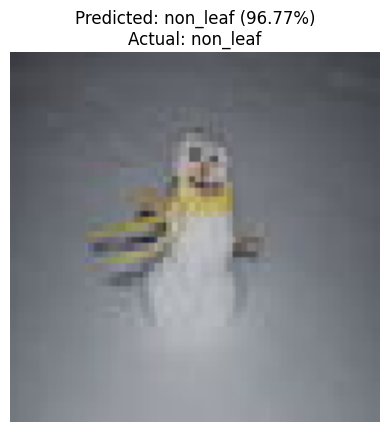

Image: image1286.jpg
Predicted: non_leaf (96.77%) | Actual: non_leaf
--------------------------------------------------


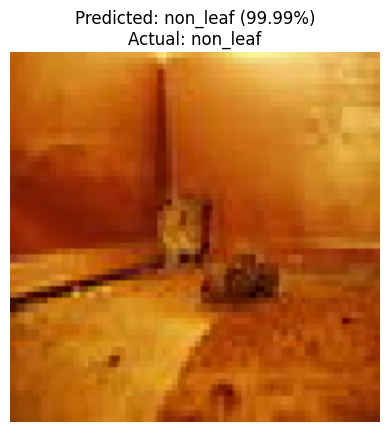

Image: image1620.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


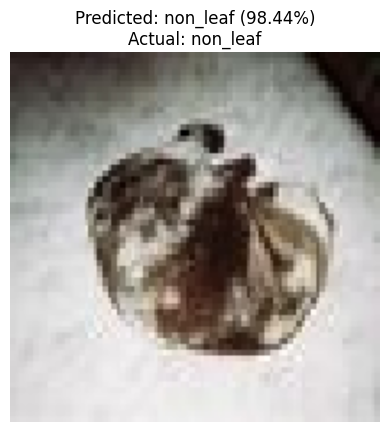

Image: image2857.jpg
Predicted: non_leaf (98.44%) | Actual: non_leaf
--------------------------------------------------


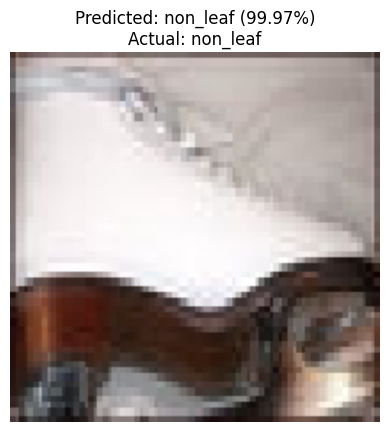

Image: image2363.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


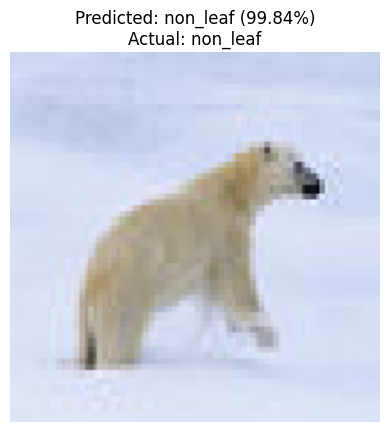

Image: image1125.jpg
Predicted: non_leaf (99.84%) | Actual: non_leaf
--------------------------------------------------


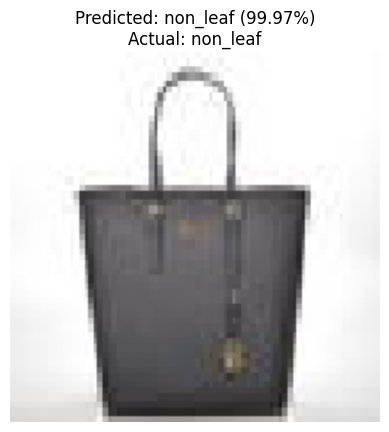

Image: image2153.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


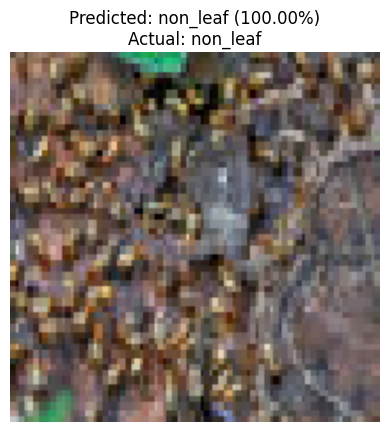

Image: image2373.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


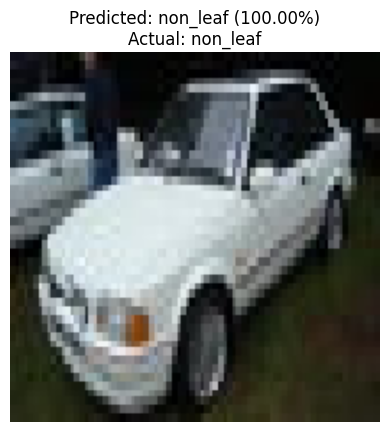

Image: image2603.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


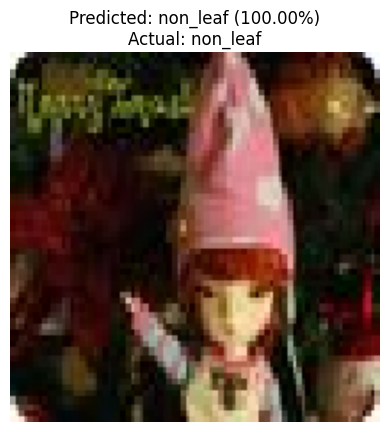

Image: image3053.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


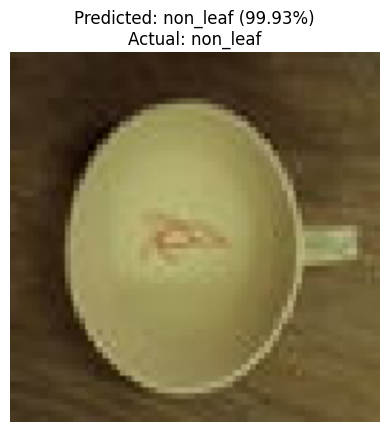

Image: image1235.jpg
Predicted: non_leaf (99.93%) | Actual: non_leaf
--------------------------------------------------


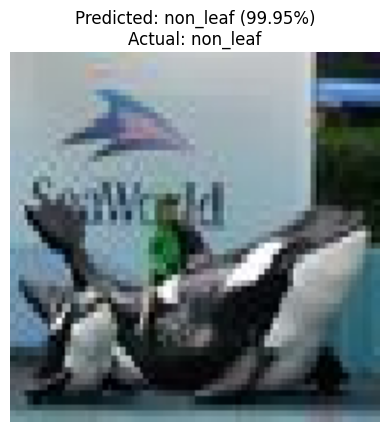

Image: image2727.jpg
Predicted: non_leaf (99.95%) | Actual: non_leaf
--------------------------------------------------


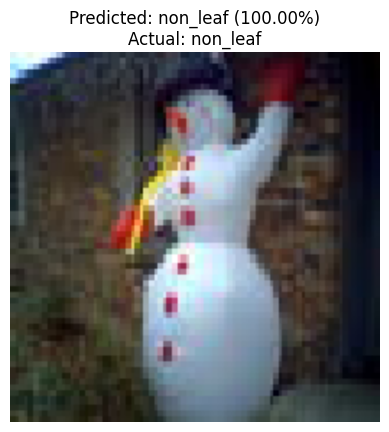

Image: image1902.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


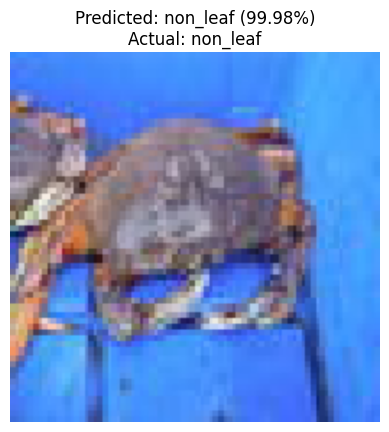

Image: image2385.jpg
Predicted: non_leaf (99.98%) | Actual: non_leaf
--------------------------------------------------


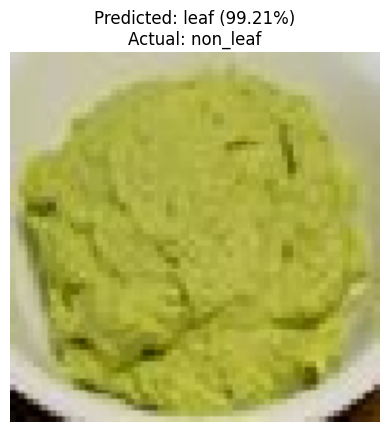

Image: image1134.jpg
Predicted: leaf (99.21%) | Actual: non_leaf
--------------------------------------------------


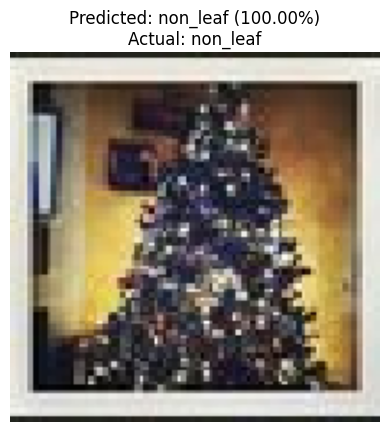

Image: image2610.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


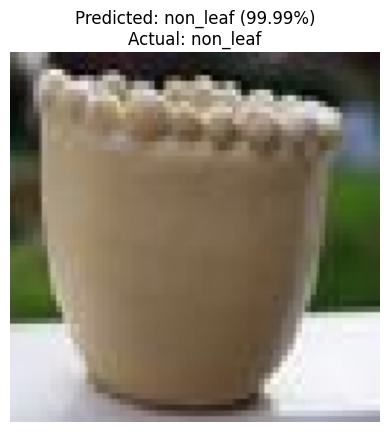

Image: image2121.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


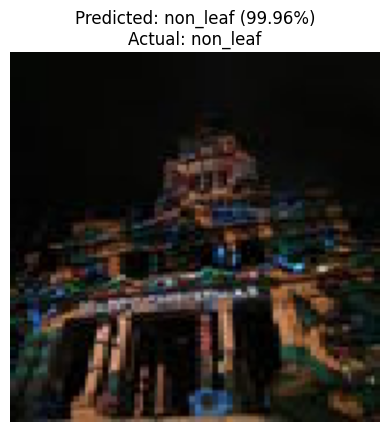

Image: image1753.jpg
Predicted: non_leaf (99.96%) | Actual: non_leaf
--------------------------------------------------


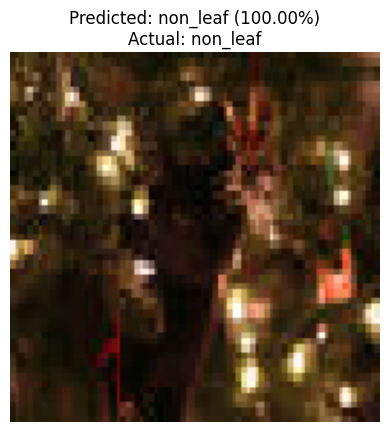

Image: image2944.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


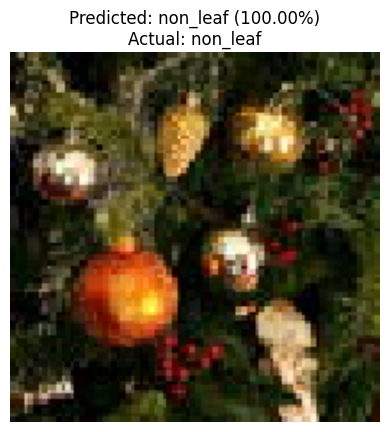

Image: image2896.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


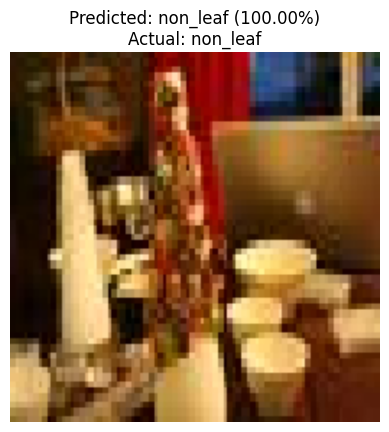

Image: image1810.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


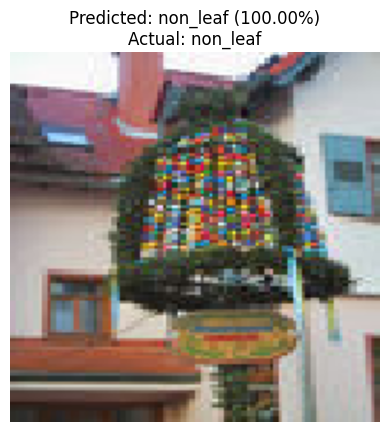

Image: image1505.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


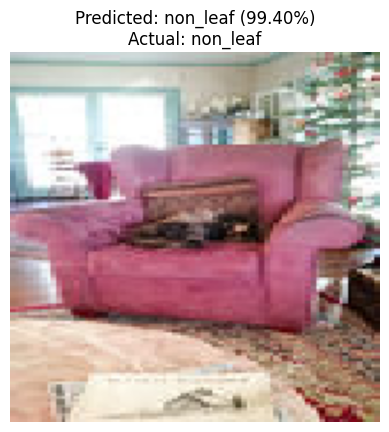

Image: image1126.jpg
Predicted: non_leaf (99.40%) | Actual: non_leaf
--------------------------------------------------


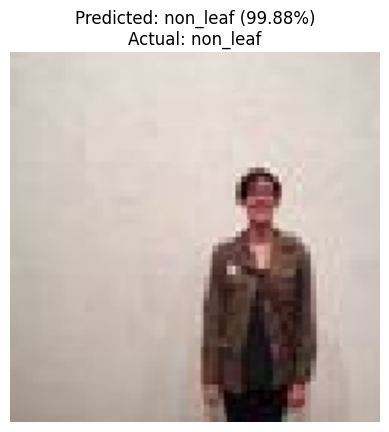

Image: image2821.jpg
Predicted: non_leaf (99.88%) | Actual: non_leaf
--------------------------------------------------


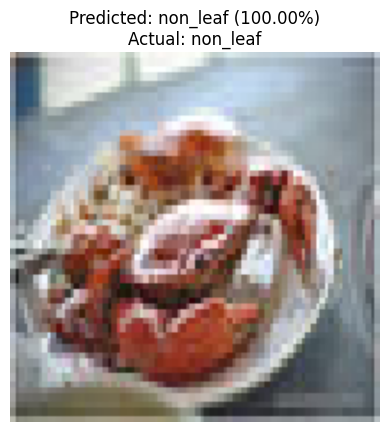

Image: image1755.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


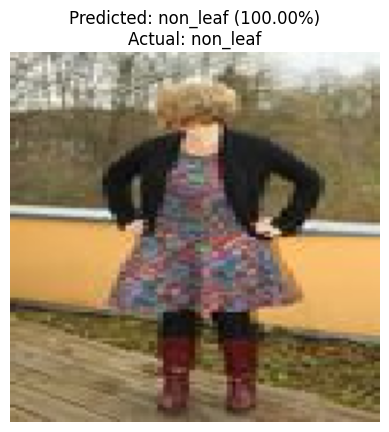

Image: image2045.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


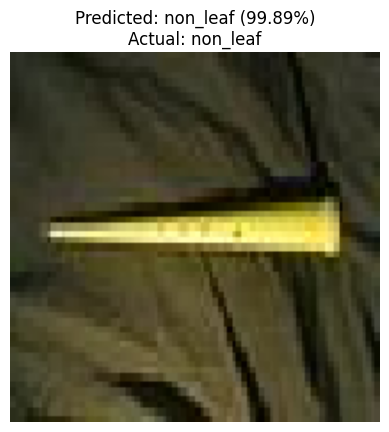

Image: image1086.jpg
Predicted: non_leaf (99.89%) | Actual: non_leaf
--------------------------------------------------


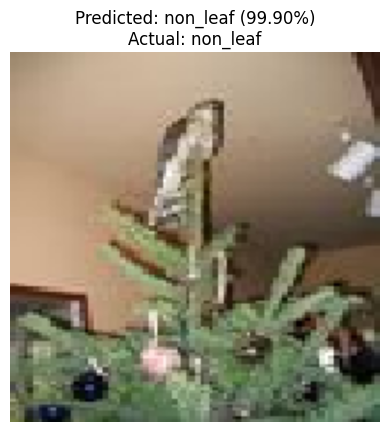

Image: image2968.jpg
Predicted: non_leaf (99.90%) | Actual: non_leaf
--------------------------------------------------


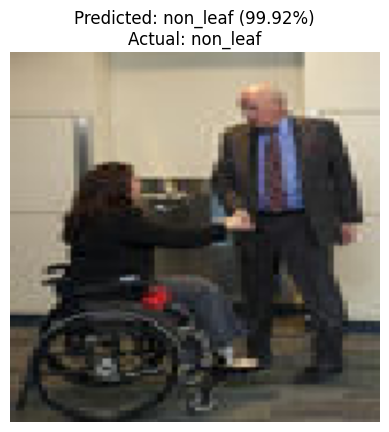

Image: image2005.jpg
Predicted: non_leaf (99.92%) | Actual: non_leaf
--------------------------------------------------


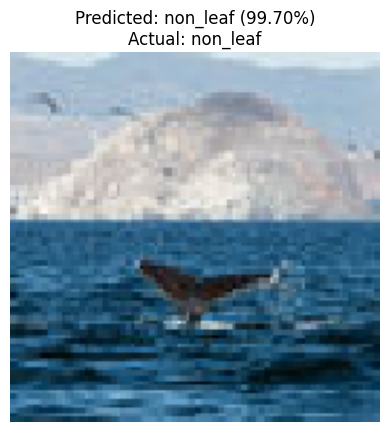

Image: image1631.jpg
Predicted: non_leaf (99.70%) | Actual: non_leaf
--------------------------------------------------


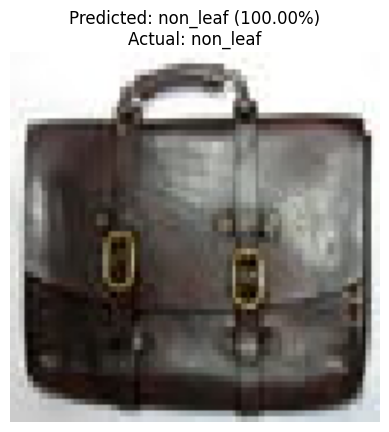

Image: image1469.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


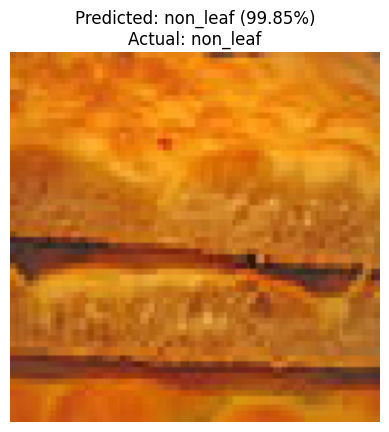

Image: image3077.jpg
Predicted: non_leaf (99.85%) | Actual: non_leaf
--------------------------------------------------


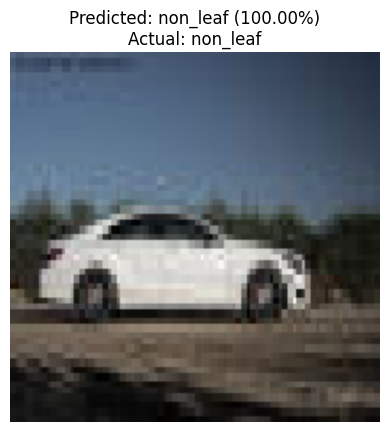

Image: image2483.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


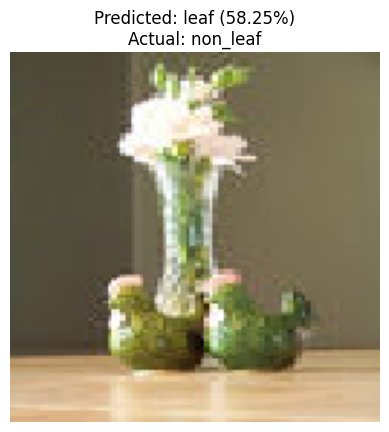

Image: image1104.jpg
Predicted: leaf (58.25%) | Actual: non_leaf
--------------------------------------------------


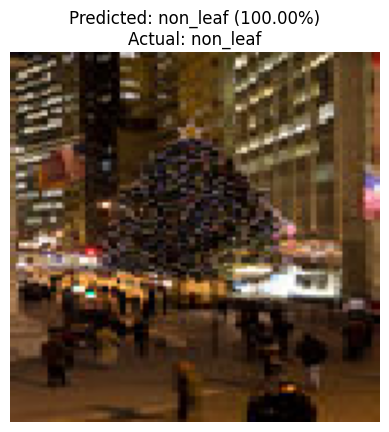

Image: image2420.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


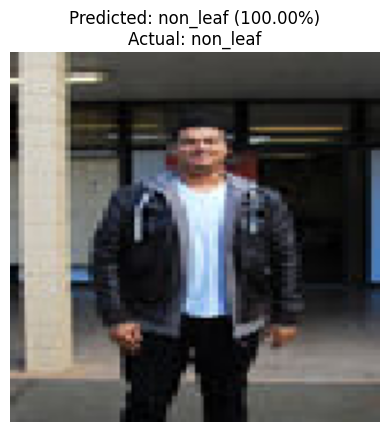

Image: image2171.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


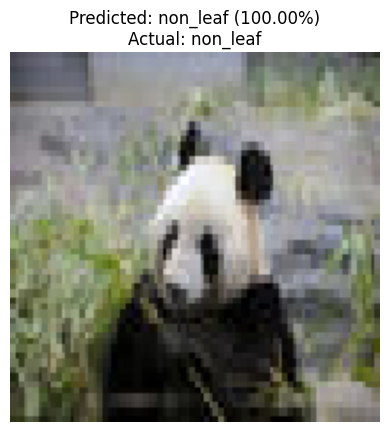

Image: image2295.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


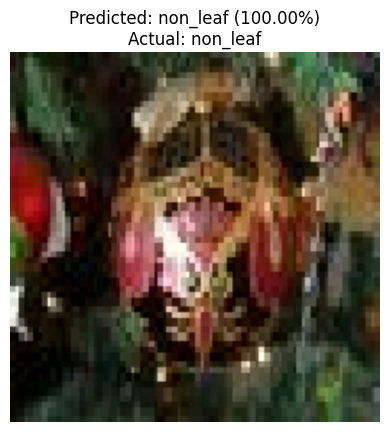

Image: image2503.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


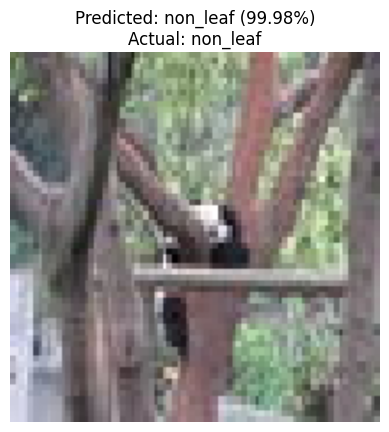

Image: image2732.jpg
Predicted: non_leaf (99.98%) | Actual: non_leaf
--------------------------------------------------


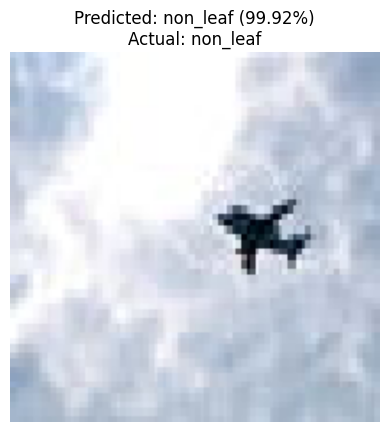

Image: image2647.jpg
Predicted: non_leaf (99.92%) | Actual: non_leaf
--------------------------------------------------


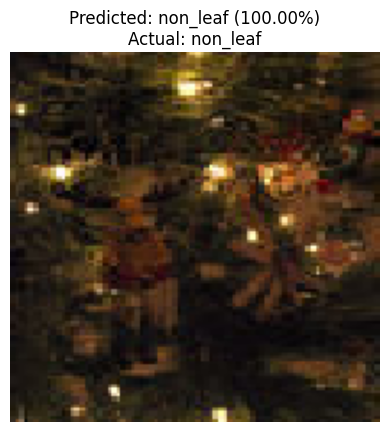

Image: image1840.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


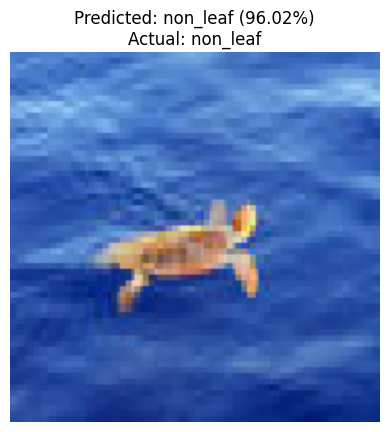

Image: image1537.jpg
Predicted: non_leaf (96.02%) | Actual: non_leaf
--------------------------------------------------


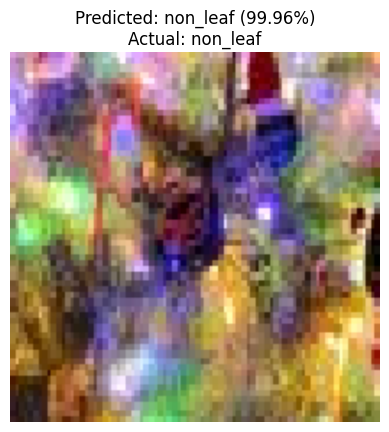

Image: image1075.jpg
Predicted: non_leaf (99.96%) | Actual: non_leaf
--------------------------------------------------


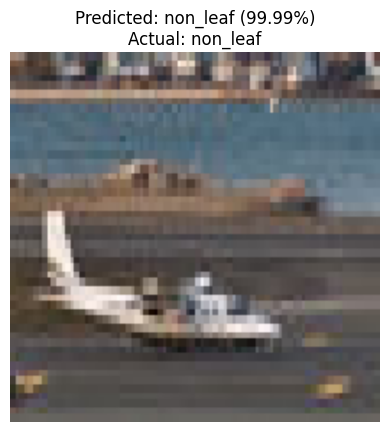

Image: image1514.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


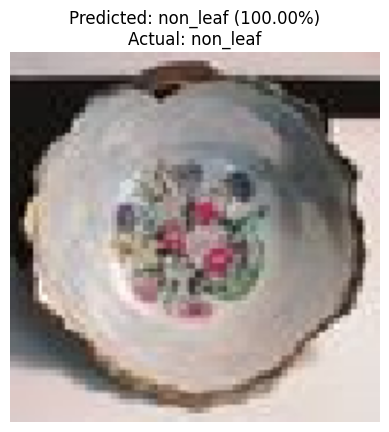

Image: image1734.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


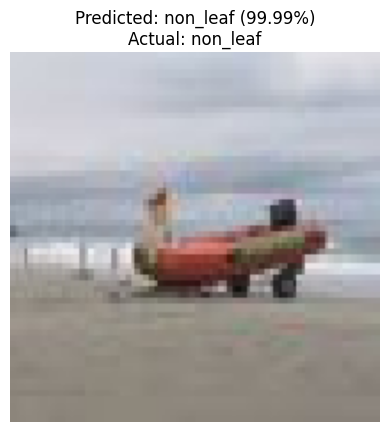

Image: image1669.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


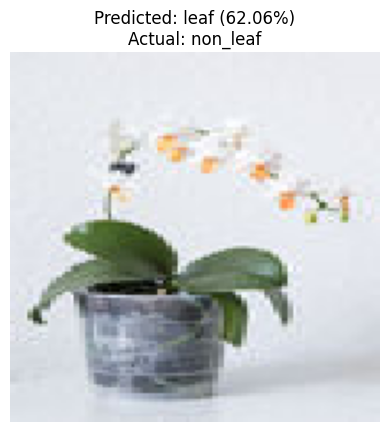

Image: image1357.jpg
Predicted: leaf (62.06%) | Actual: non_leaf
--------------------------------------------------


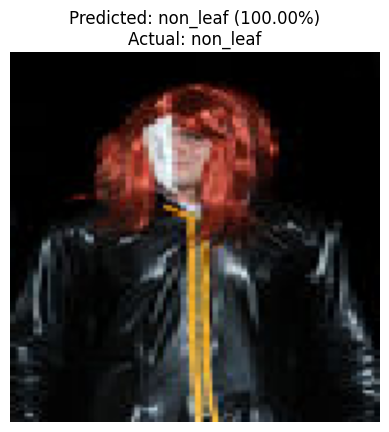

Image: image2394.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


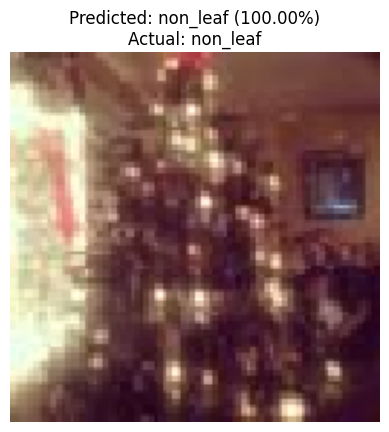

Image: image1293.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


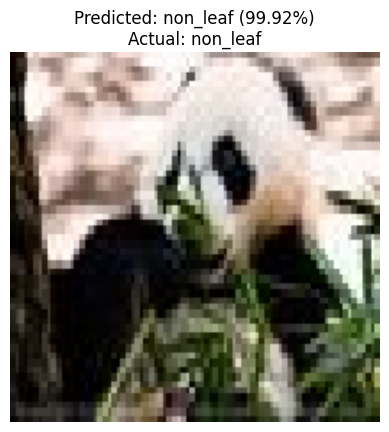

Image: image1121.jpg
Predicted: non_leaf (99.92%) | Actual: non_leaf
--------------------------------------------------


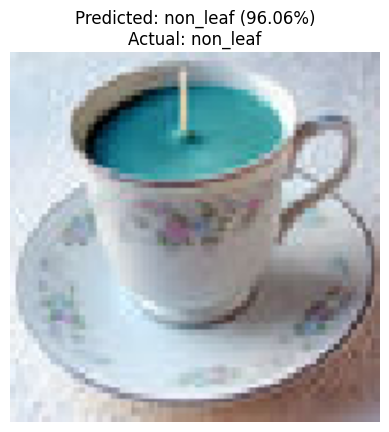

Image: image2028.jpg
Predicted: non_leaf (96.06%) | Actual: non_leaf
--------------------------------------------------


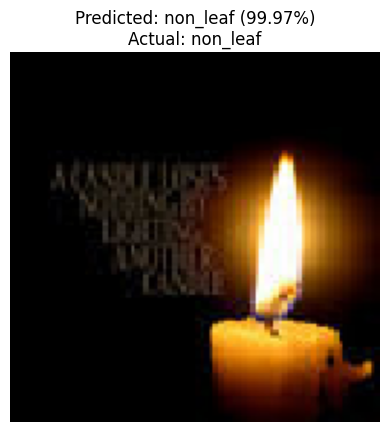

Image: image1261.jpg
Predicted: non_leaf (99.97%) | Actual: non_leaf
--------------------------------------------------


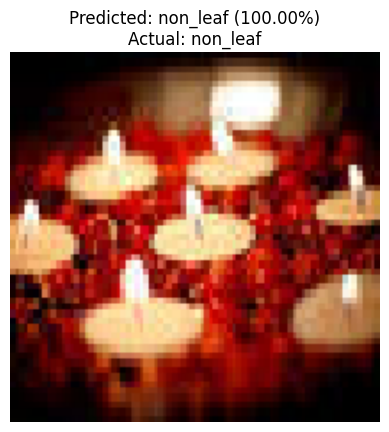

Image: image2241.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


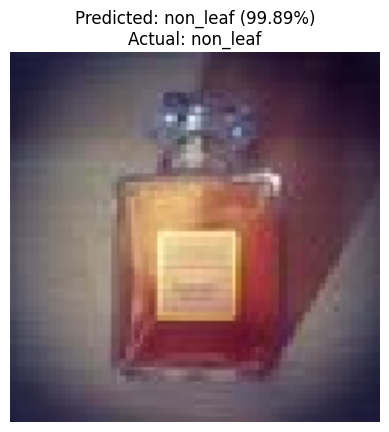

Image: image1655.jpg
Predicted: non_leaf (99.89%) | Actual: non_leaf
--------------------------------------------------


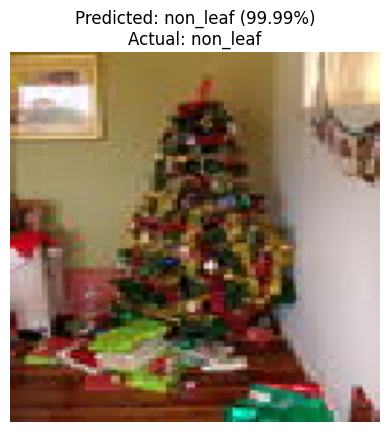

Image: image1575.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


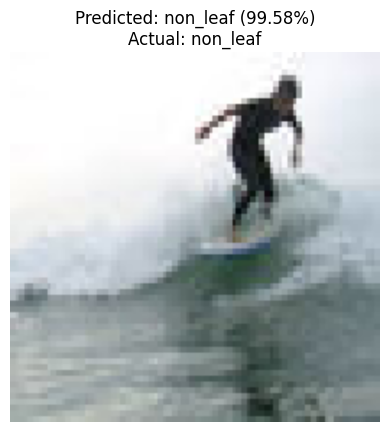

Image: image2230.jpg
Predicted: non_leaf (99.58%) | Actual: non_leaf
--------------------------------------------------


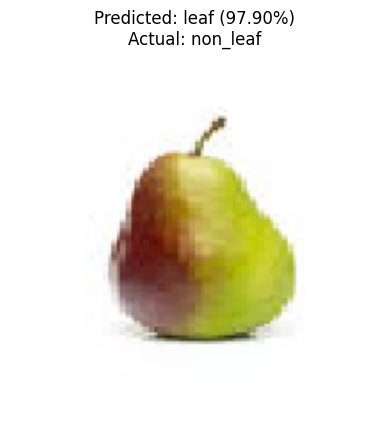

Image: image3032.jpg
Predicted: leaf (97.90%) | Actual: non_leaf
--------------------------------------------------


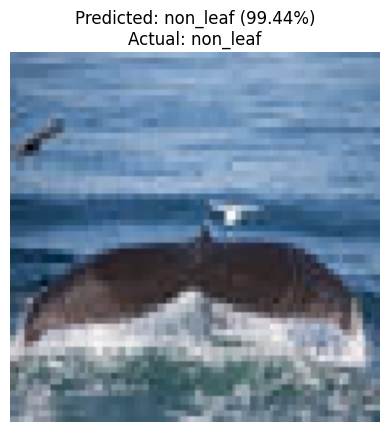

Image: image2492.jpg
Predicted: non_leaf (99.44%) | Actual: non_leaf
--------------------------------------------------


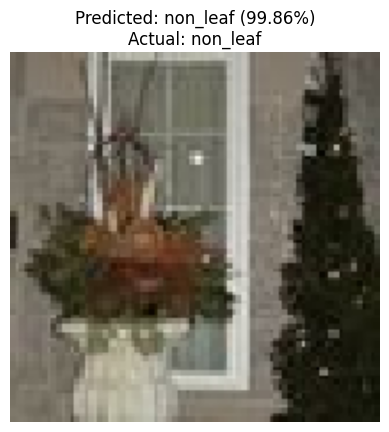

Image: image2616.jpg
Predicted: non_leaf (99.86%) | Actual: non_leaf
--------------------------------------------------


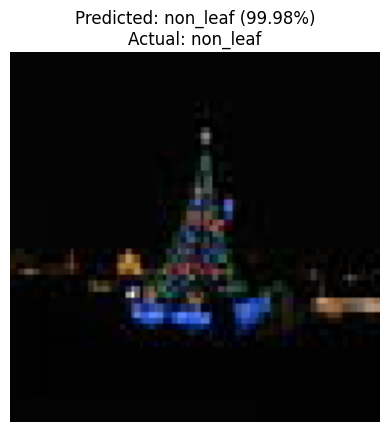

Image: image2168.jpg
Predicted: non_leaf (99.98%) | Actual: non_leaf
--------------------------------------------------


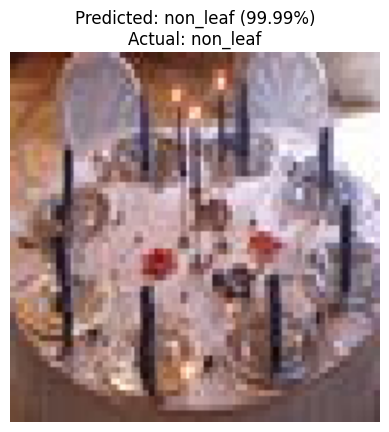

Image: image2187.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


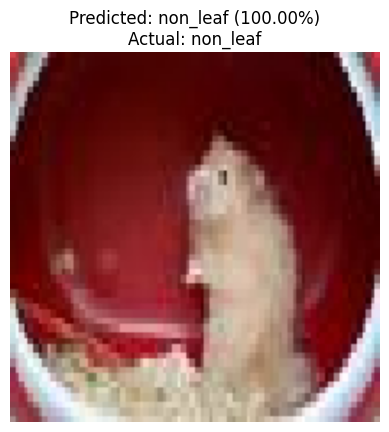

Image: image2088.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


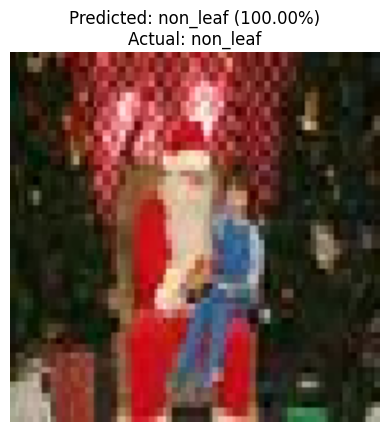

Image: image1455.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


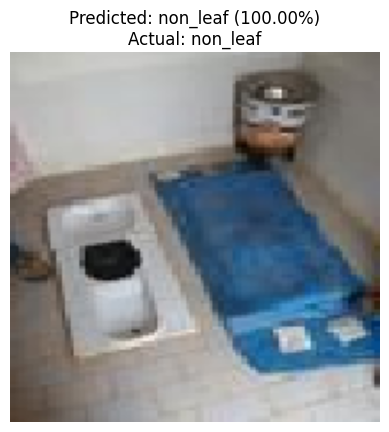

Image: image1704.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


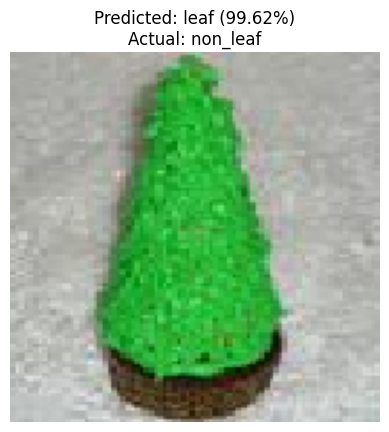

Image: image1460.jpg
Predicted: leaf (99.62%) | Actual: non_leaf
--------------------------------------------------


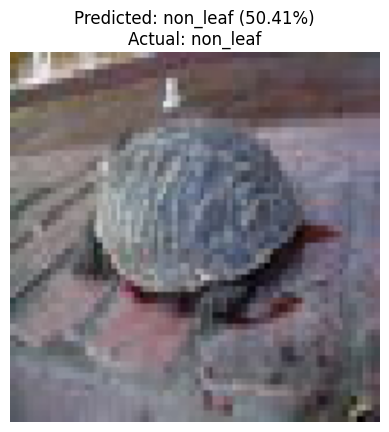

Image: image1439.jpg
Predicted: non_leaf (50.41%) | Actual: non_leaf
--------------------------------------------------


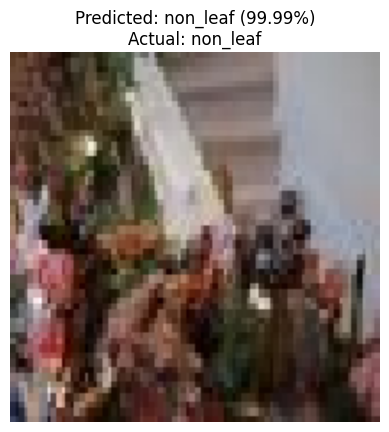

Image: image1501.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


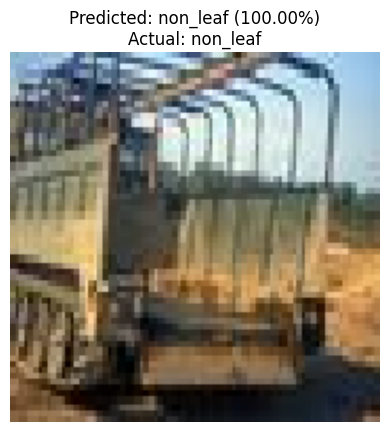

Image: image1816.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


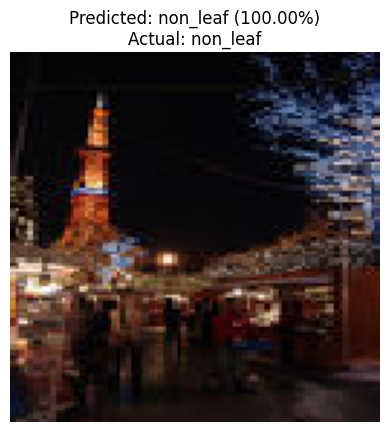

Image: image2774.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


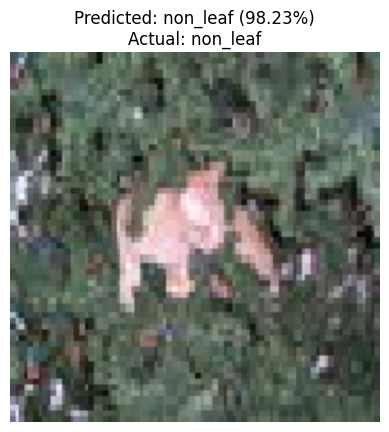

Image: image1706.jpg
Predicted: non_leaf (98.23%) | Actual: non_leaf
--------------------------------------------------


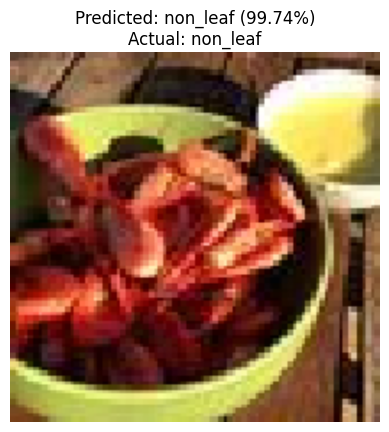

Image: image2632.jpg
Predicted: non_leaf (99.74%) | Actual: non_leaf
--------------------------------------------------


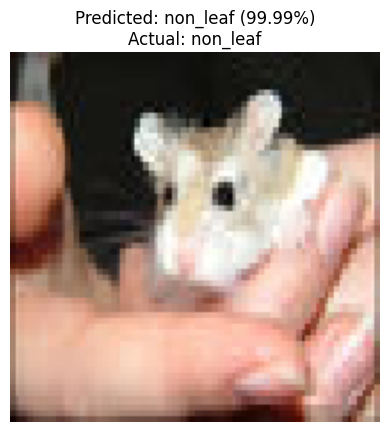

Image: image2424.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


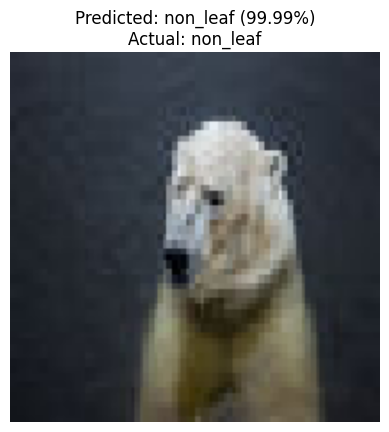

Image: image2410.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


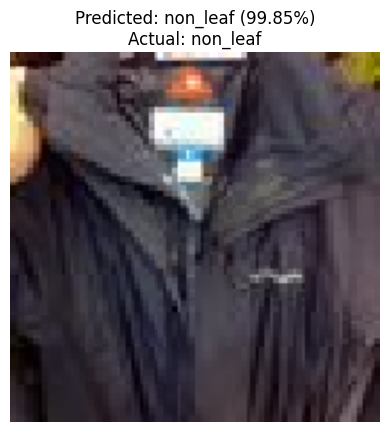

Image: image1989.jpg
Predicted: non_leaf (99.85%) | Actual: non_leaf
--------------------------------------------------


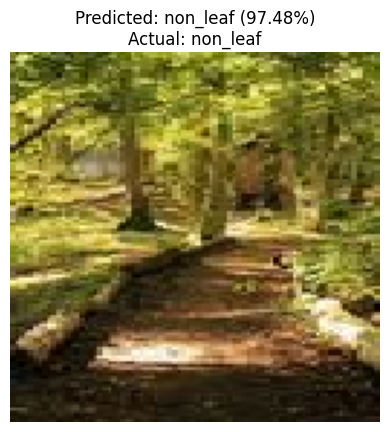

Image: image2501.jpg
Predicted: non_leaf (97.48%) | Actual: non_leaf
--------------------------------------------------


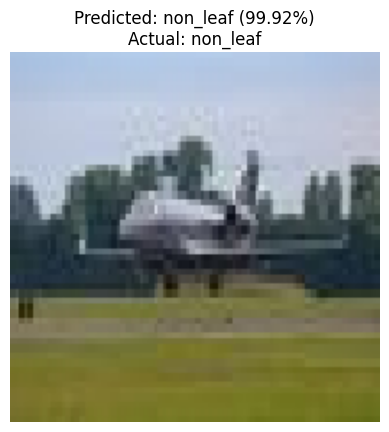

Image: image2004.jpg
Predicted: non_leaf (99.92%) | Actual: non_leaf
--------------------------------------------------


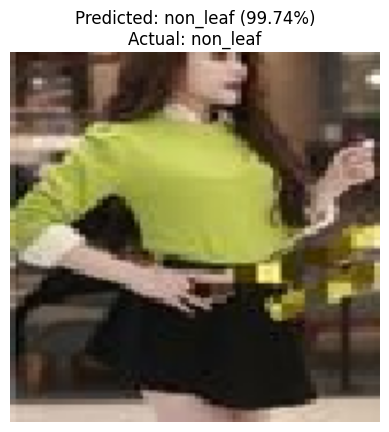

Image: image2395.jpg
Predicted: non_leaf (99.74%) | Actual: non_leaf
--------------------------------------------------


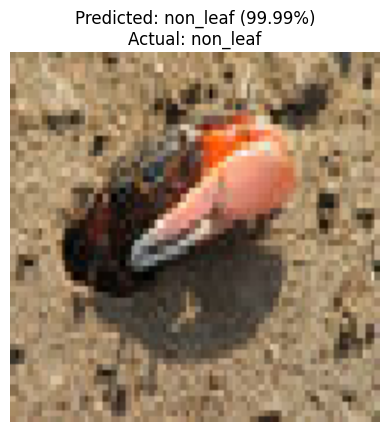

Image: image2156.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


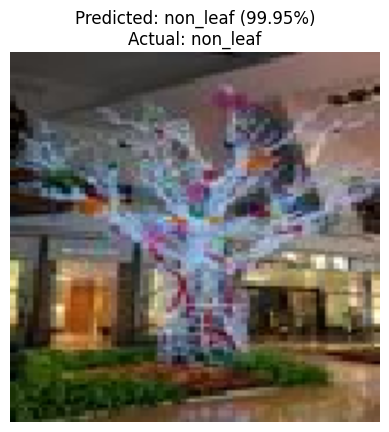

Image: image1333.jpg
Predicted: non_leaf (99.95%) | Actual: non_leaf
--------------------------------------------------


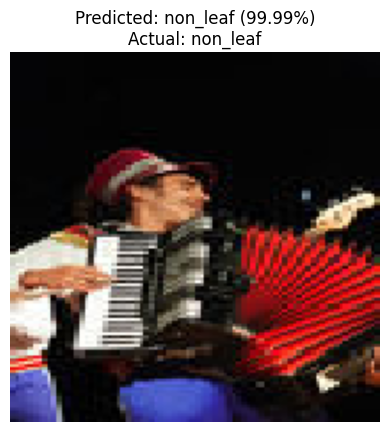

Image: image2151.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


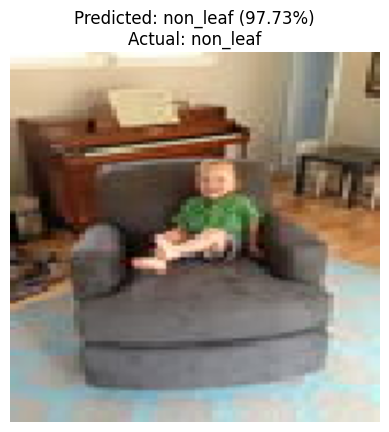

Image: image2548.jpg
Predicted: non_leaf (97.73%) | Actual: non_leaf
--------------------------------------------------


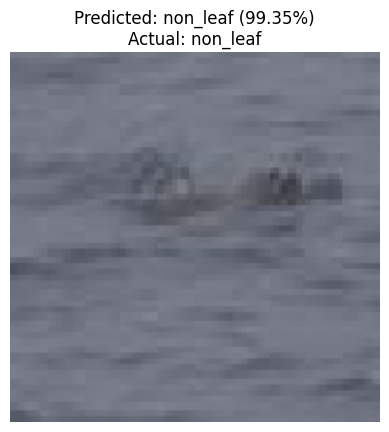

Image: image1281.jpg
Predicted: non_leaf (99.35%) | Actual: non_leaf
--------------------------------------------------


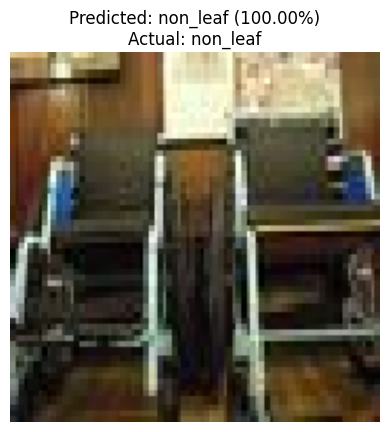

Image: image2621.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


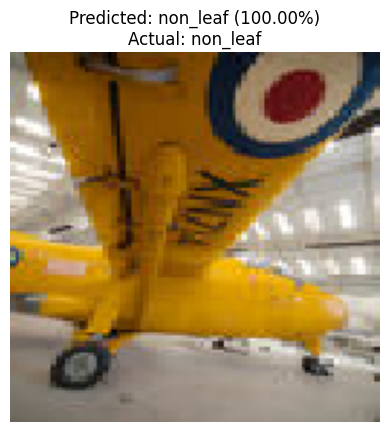

Image: image2997.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


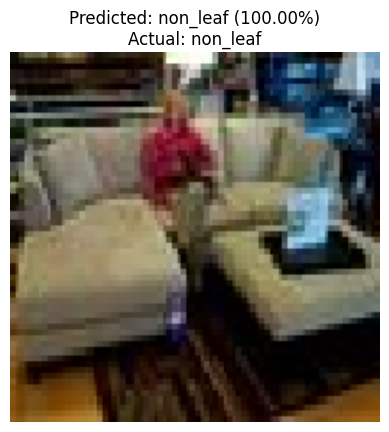

Image: image2476.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


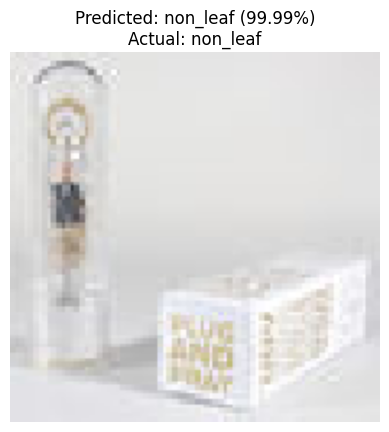

Image: image3025.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


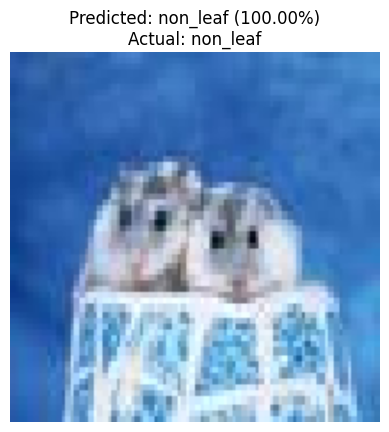

Image: image2054.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


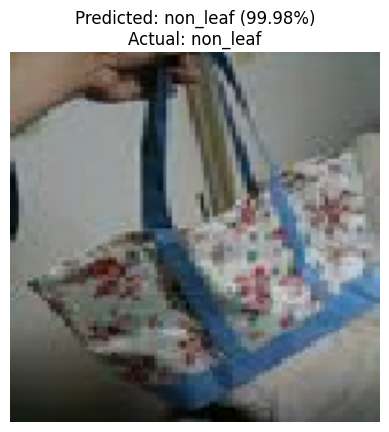

Image: image1236.jpg
Predicted: non_leaf (99.98%) | Actual: non_leaf
--------------------------------------------------


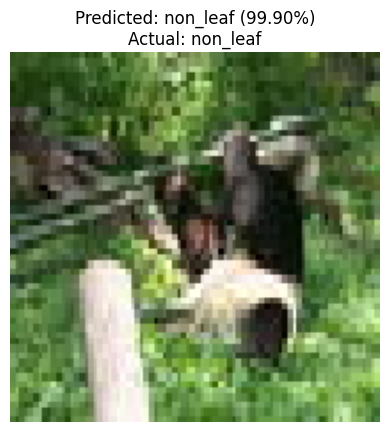

Image: image1522.jpg
Predicted: non_leaf (99.90%) | Actual: non_leaf
--------------------------------------------------


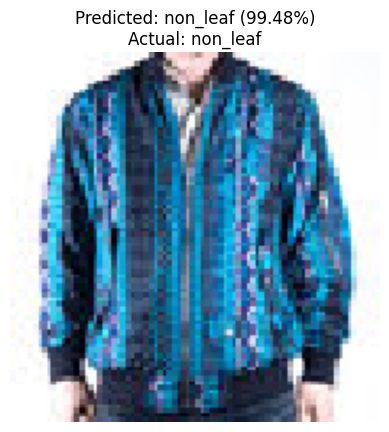

Image: image1712.jpg
Predicted: non_leaf (99.48%) | Actual: non_leaf
--------------------------------------------------


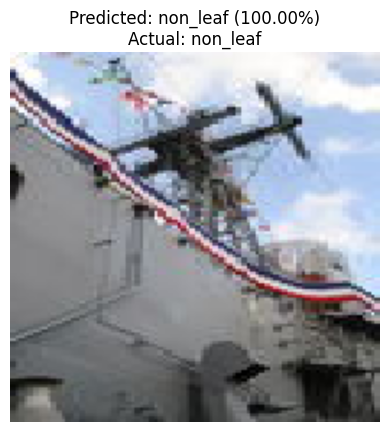

Image: image2489.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


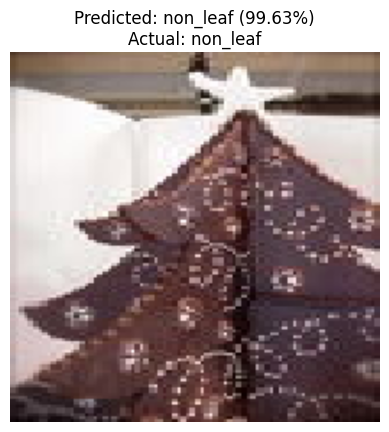

Image: image1657.jpg
Predicted: non_leaf (99.63%) | Actual: non_leaf
--------------------------------------------------


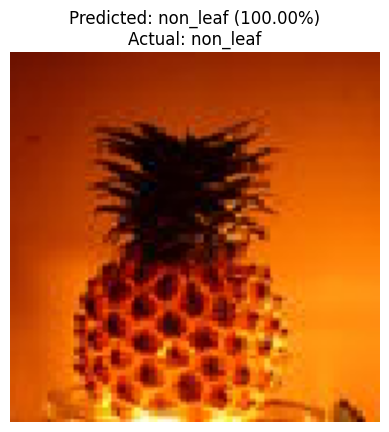

Image: image2496.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


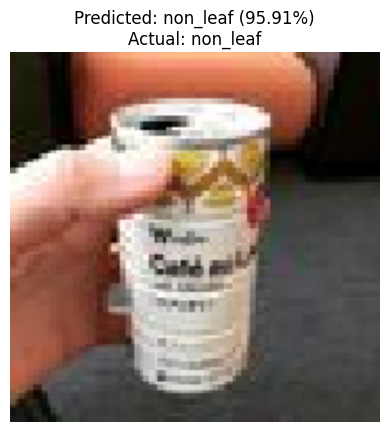

Image: image1383.jpg
Predicted: non_leaf (95.91%) | Actual: non_leaf
--------------------------------------------------


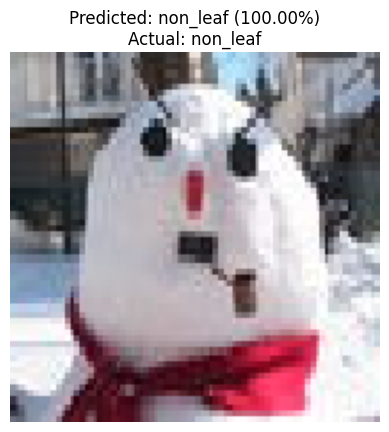

Image: image1230.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


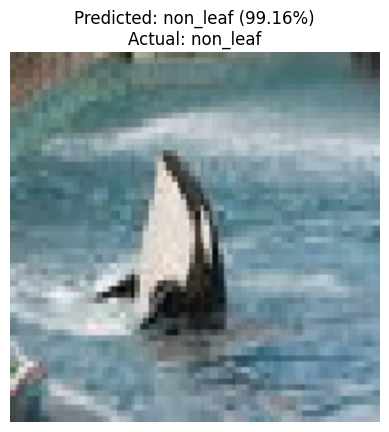

Image: image2207.jpg
Predicted: non_leaf (99.16%) | Actual: non_leaf
--------------------------------------------------


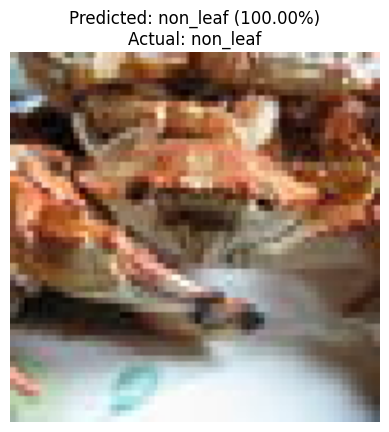

Image: image2146.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


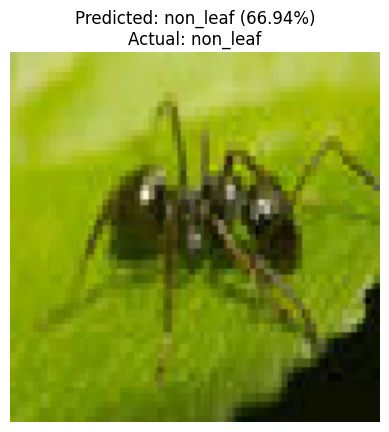

Image: image1789.jpg
Predicted: non_leaf (66.94%) | Actual: non_leaf
--------------------------------------------------


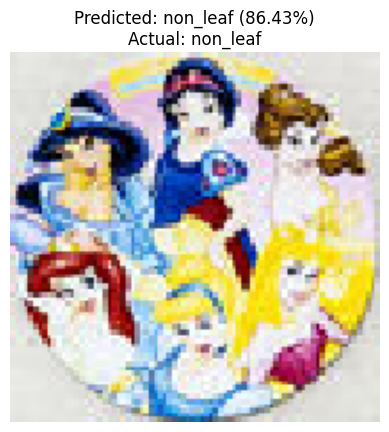

Image: image2029.jpg
Predicted: non_leaf (86.43%) | Actual: non_leaf
--------------------------------------------------


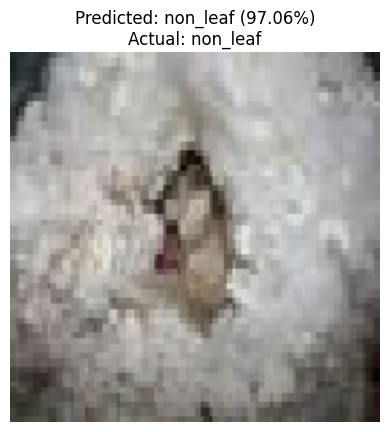

Image: image1447.jpg
Predicted: non_leaf (97.06%) | Actual: non_leaf
--------------------------------------------------


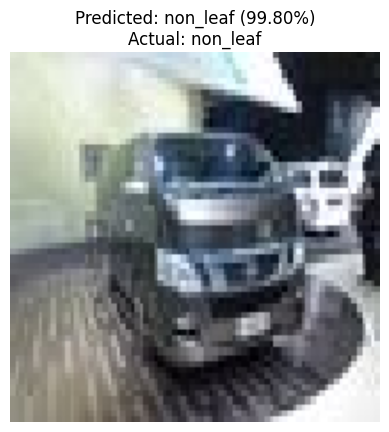

Image: image1678.jpg
Predicted: non_leaf (99.80%) | Actual: non_leaf
--------------------------------------------------


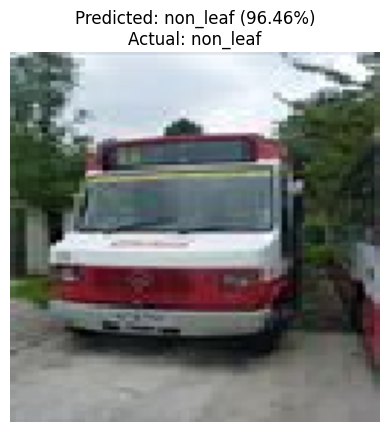

Image: image1905.jpg
Predicted: non_leaf (96.46%) | Actual: non_leaf
--------------------------------------------------


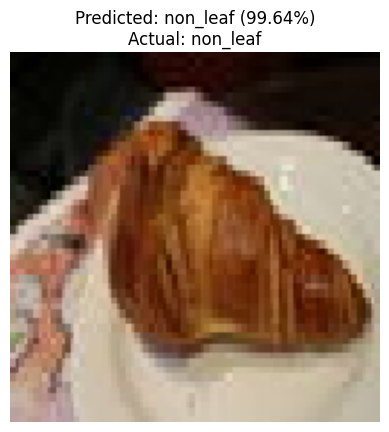

Image: image1719.jpg
Predicted: non_leaf (99.64%) | Actual: non_leaf
--------------------------------------------------


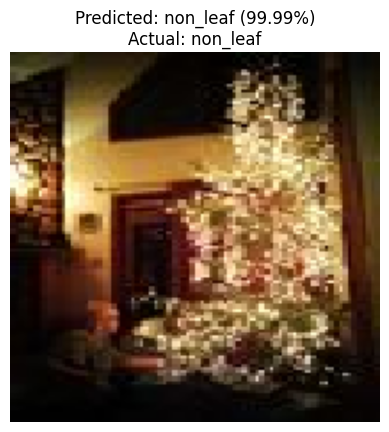

Image: image2160.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


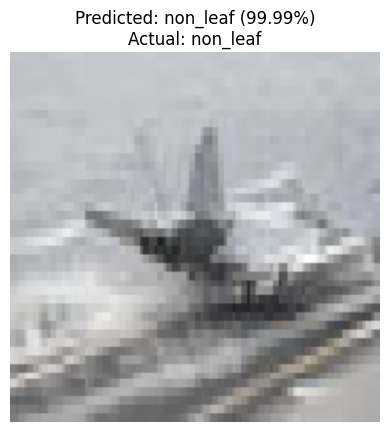

Image: image1295.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


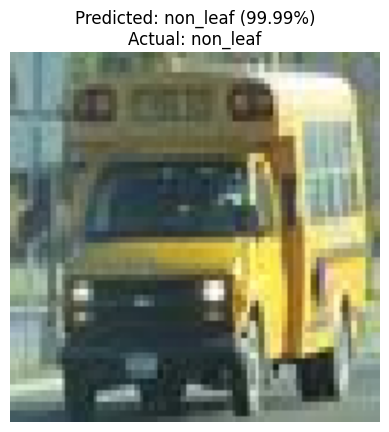

Image: image2132.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


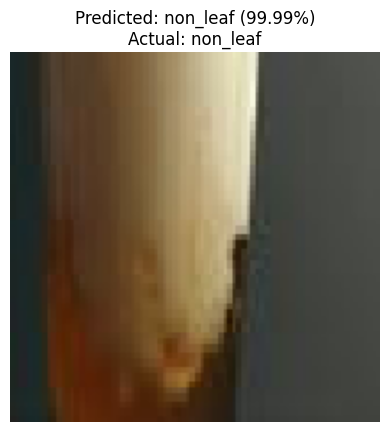

Image: image1395.jpg
Predicted: non_leaf (99.99%) | Actual: non_leaf
--------------------------------------------------


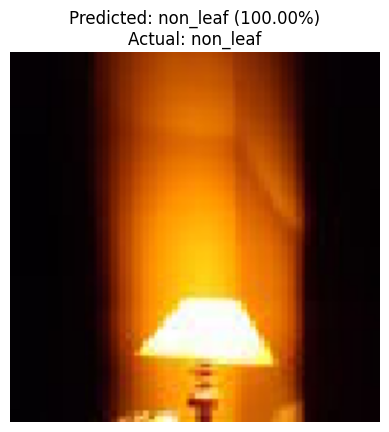

Image: image2456.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


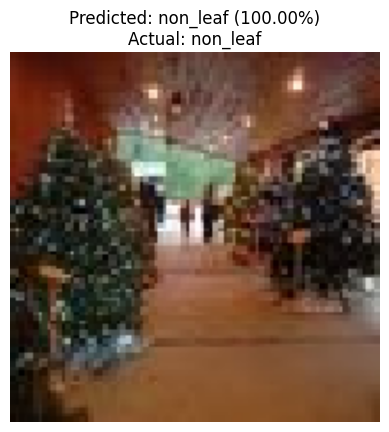

Image: image2103.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


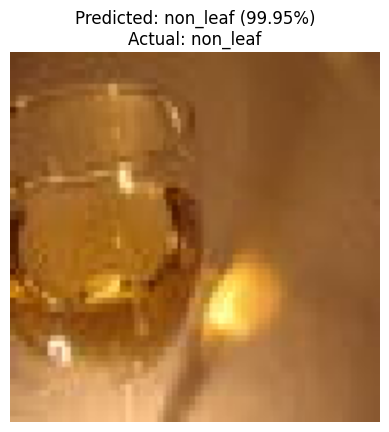

Image: image1672.jpg
Predicted: non_leaf (99.95%) | Actual: non_leaf
--------------------------------------------------


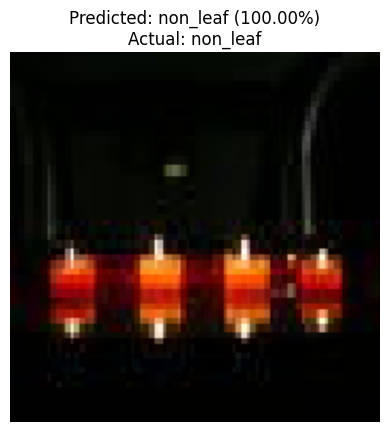

Image: image1078.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


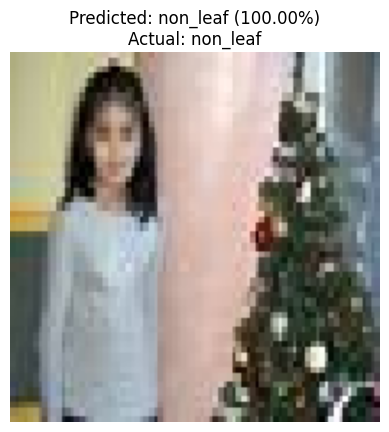

Image: image1831.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


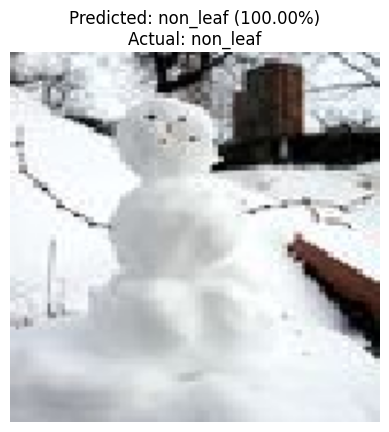

Image: image2234.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


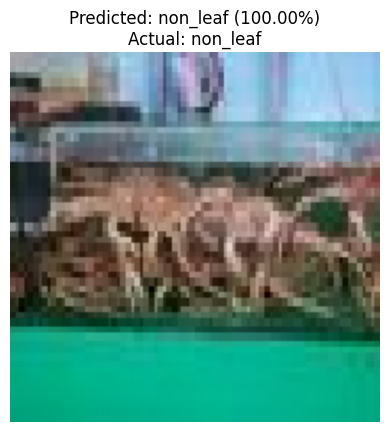

Image: image2240.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------


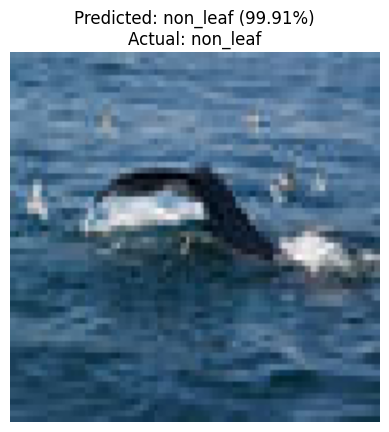

Image: image1769.jpg
Predicted: non_leaf (99.91%) | Actual: non_leaf
--------------------------------------------------


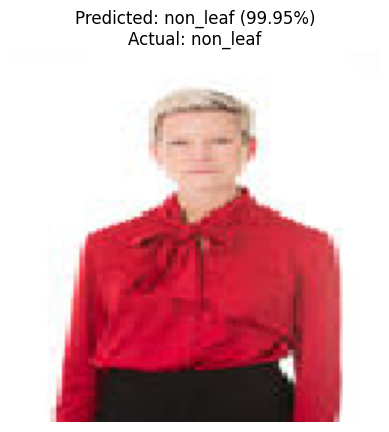

Image: image1843.jpg
Predicted: non_leaf (99.95%) | Actual: non_leaf
--------------------------------------------------


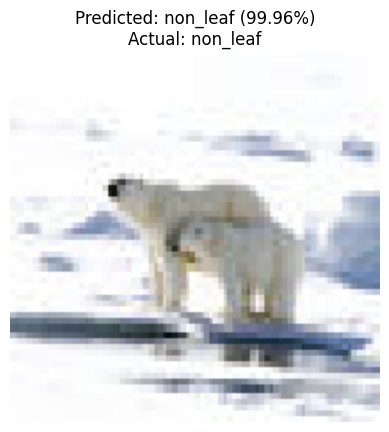

Image: image2581.jpg
Predicted: non_leaf (99.96%) | Actual: non_leaf
--------------------------------------------------


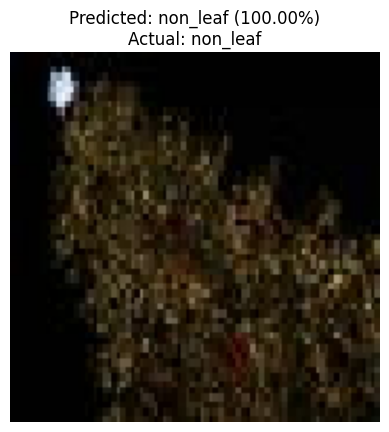

Image: image2817.jpg
Predicted: non_leaf (100.00%) | Actual: non_leaf
--------------------------------------------------

=== Checking images in class: leaf ===


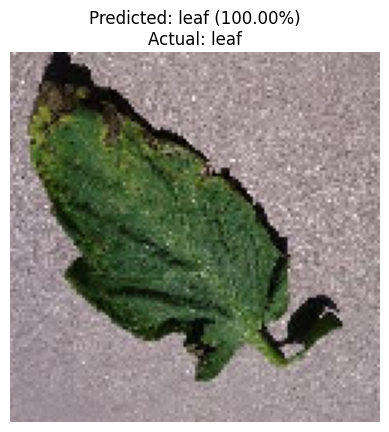

Image: 09033832-a345-408c-823e-a4081d7fbbf4___JR_Sept.L.S 8523.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


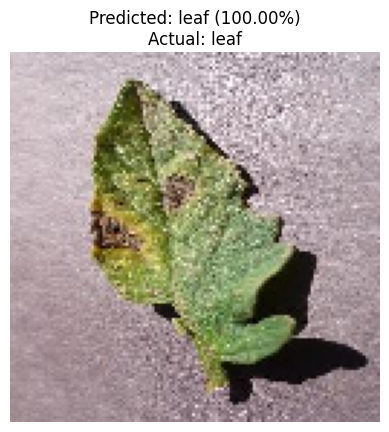

Image: d60c253c-b97e-4076-8eac-bae34e1bbdc9___RS_Erly.B 7749.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


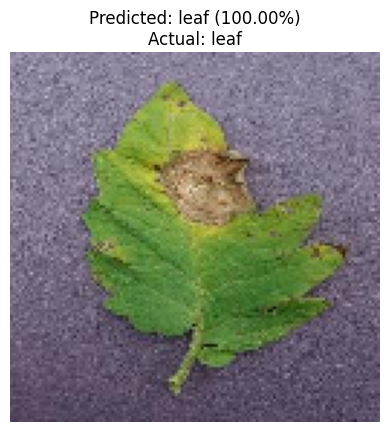

Image: 9784efc5-3e57-4d12-9912-9a06cb6d56fb___Keller.St_CG 1863.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


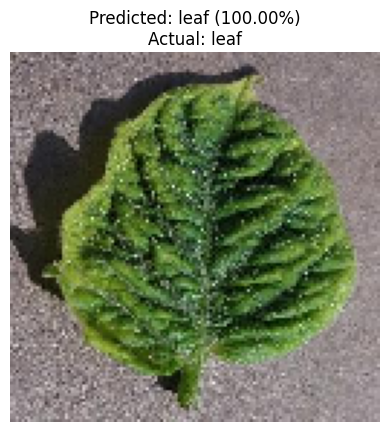

Image: 3f5fc513-d7bb-49ba-aa11-bf01f36fa977___YLCV_GCREC 2061.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


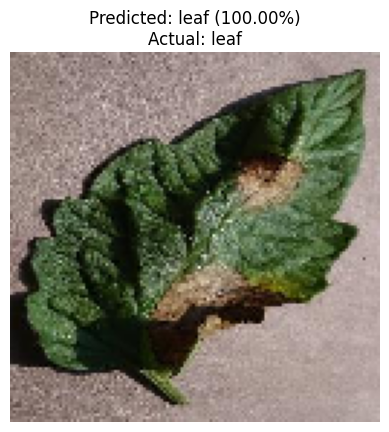

Image: f7e7a40f-335d-45a6-b086-3f6b9779a5a0___RS_Late.B 4903.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


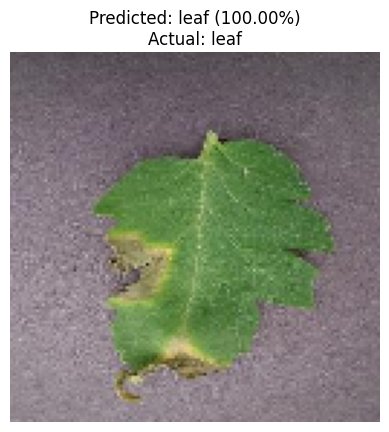

Image: d56280c8-1442-476c-bdc8-8bb99edad8dd___GHLB2 Leaf 8847.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


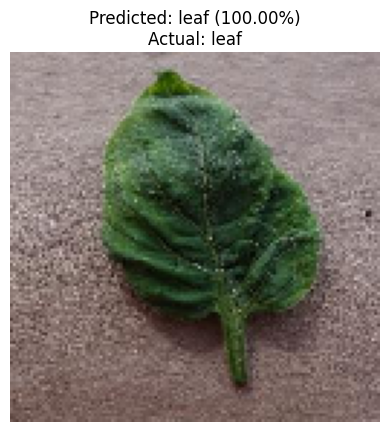

Image: 20ac2726-7671-41b7-87e2-1dc6255aa27a___YLCV_NREC 2608.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


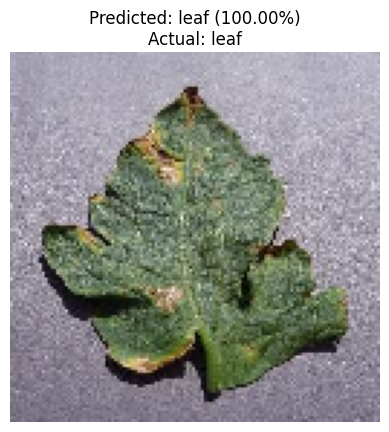

Image: 68055370-6691-48ef-b3e5-abbceed4149d___Com.G_TgS_FL 0639.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


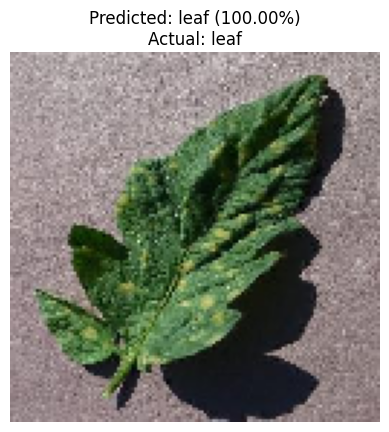

Image: bccf2fe9-b834-47bf-b0c3-ecdc41c56614___Crnl_L.Mold 6523.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


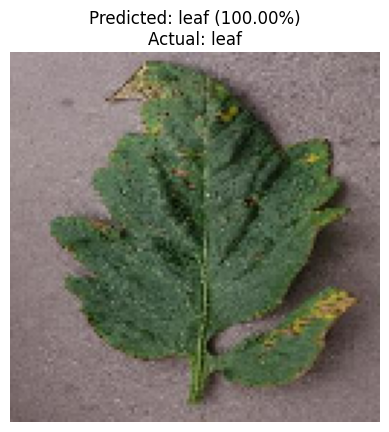

Image: 3f71f836-8ffa-4bf7-98f7-e5cff0887fe1___GCREC_Bact.Sp 3814.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


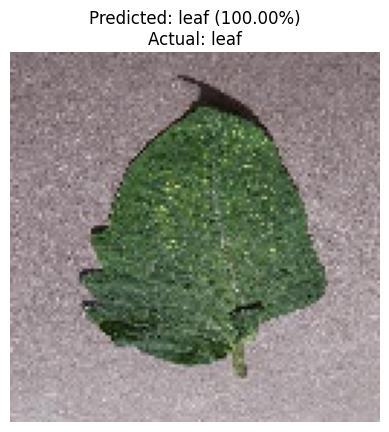

Image: a1b54d81-e157-4617-9d9e-c3335c7c7efd___Com.G_SpM_FL 9634.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


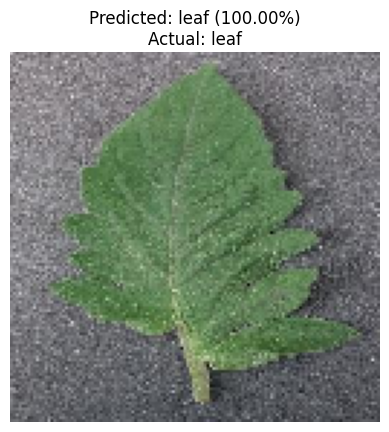

Image: 2a1dd125-ece3-499f-a24b-1d00dbcc3184___GH_HL Leaf 227.JPG
Predicted: leaf (100.00%) | Actual: leaf
--------------------------------------------------


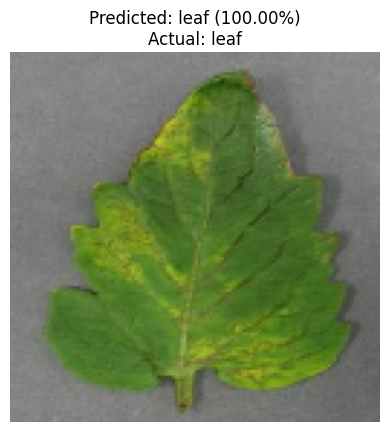

In [ ]:
predict_all_from_test(model)